### Imports

In [1]:
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:100% !important; }</style>"))

/tmp/ipykernel_502334/3777615979.py:1: DeprecationWarning: Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display
  from IPython.core.display import display, HTML


In [3]:
import torch
import pandas as pd
import numpy as np
import yaml
import matplotlib.pyplot as plt
from sklearn.metrics.pairwise import cosine_similarity, cosine_distances
from umap import UMAP
from sklearn.preprocessing import StandardScaler
from scipy.cluster.hierarchy import dendrogram, linkage, fcluster
from label_dict import protein_to_num_single_cells, protein_to_num_full
from tqdm import tqdm
from scipy.stats import ttest_ind, zscore, norm
from statsmodels.stats.weightstats import ztest as ztest
from skimage import io
from matplotlib import cm
from scipy.cluster.hierarchy import dendrogram, linkage, fcluster
from scipy.spatial.distance import pdist
from seaborn import clustermap
from scipy.spatial.distance import squareform
cmap = cm.jet


In [4]:
cmap = cm.nipy_spectral

def get_embeddings(features):
    scaled_features = StandardScaler().fit_transform(features.numpy())
    reducer = UMAP(init='random', random_state=42)
    embedding = reducer.fit_transform(scaled_features)
    return embedding

def plot_UMAP(df, labels, embedding, title):
    mat, labels = get_col_matrix(df, labels)
    plt.figure(figsize=(10,10), facecolor='white')
    plt.scatter(embedding[:, 0], 
                embedding[:, 1],
                s=0.1,
                label='All data',
                color='grey'
               )
    for i in range(mat.shape[1]):
        indices = np.where((mat[:, i] == 1) & (mat[:,:].sum(axis=1) == 1))[0]
        plt.scatter(embedding[indices, 0], 
                    embedding[indices, 1],
                    s=0.1,
                    label=labels[i],
                    color=cmap(i / mat.shape[1])
                   )

    plt.xlabel('UMAP 1')
    plt.ylabel('UMAP 2')
    plt.title(title, fontsize=15)
    lgnd = plt.legend(bbox_to_anchor=(1,1), frameon=False)
    for h in lgnd.legendHandles:
        h._sizes = [30]

def get_col_matrix(df, labels):
    if len(labels) == 1:
        values = df[labels[0]]
        unique_values = sorted(np.unique(values))
        mat = np.zeros((len(df), len(unique_values)))
        for ind, value in enumerate(unique_values):
            mat[np.where(values == value)[0], ind] = 1
        columns = unique_values
    else:
        mat = df[sorted(labels)].values.astype(int)
        columns = sorted(labels)
    return mat, columns

def get_averaged_features(df, features, labels):
    mat, columns = get_col_matrix(df, labels)
    averaged_features = []
    for key in range(len(columns)):
        indices = np.where(mat[:,key])
        averaged_features.append(features[indices].mean(axis=0))
    averaged_features = torch.stack(averaged_features)
    return averaged_features, columns

def get_heirarchical_clustering(df, features, labels):
    averaged_features, columns = get_averaged_features(df, features, labels)
    distance_matrix = cosine_similarity(averaged_features, averaged_features)
    Z = linkage(distance_matrix)
    plt.figure(figsize=(20,5))
    dn = dendrogram(Z, labels = columns)
    plt.xticks(rotation=45)
    distance_matrix = distance_matrix[dn['leaves'], :][:, dn['leaves']]
    columns = dn['ivl']
    plt.figure(figsize=(10,10))
    plt.imshow(distance_matrix)
    plt.xticks(range(len(columns)), columns, rotation=90)
    plt.yticks(range(len(columns)), columns)
    return distance_matrix, columns

def get_heterogeneousity_per_whole_image(df, features, indices, metric='distance', verbose=False):
    cells_per_ID = df.iloc[indices].groupby('ID').groups
    mean_distances_per_ID = []
    for ID in tqdm(sorted(cells_per_ID.keys()), disable=verbose == False):
        if metric == 'distance':
            distance_matrix = cosine_distances(features[cells_per_ID[ID]], 
                                                features[cells_per_ID[ID]])
            distances = np.triu(distance_matrix)[np.triu_indices(distance_matrix.shape[0], k=1)]
            if len(distances) == 0: continue
            mean_distances_per_ID.append(distances.mean())
        elif metric == 'std':
            mean_distances_per_ID.append(features[cells_per_ID[ID]].std(axis=0).mean().item())
    return mean_distances_per_ID, sorted(cells_per_ID.keys())

def get_heterogeneousity_per_gene(merged_df, features, indices, metric='distance', verbose=False):
    cells_per_gene = merged_df.iloc[indices].groupby(['Gene','cell_type']).groups
    keys = sorted(cells_per_gene.keys())
    mean_distances_per_ID = []
    for gene in tqdm(keys):
        if metric == 'distance':
            distance_matrix = cosine_distances(features[merged_df.iloc[cells_per_gene[gene]].original_index.values], 
                                                features[merged_df.iloc[cells_per_gene[gene]].original_index.values])
            distances = np.triu(distance_matrix)[np.triu_indices(distance_matrix.shape[0], k=1)]
            if len(distances) == 0: continue
            mean_distances_per_ID.append(distances.mean())
        elif metric == 'std':
            mean_distances_per_ID.append(features[merged_df.iloc[cells_per_gene[gene]].original_index.values].std(axis=0).mean().item())
    return mean_distances_per_ID, keys

def plot_heterogeneity(mean_distances_hetero, mean_distances_homo):
    p_value = ttest_ind(mean_distances_hetero, mean_distances_homo)[1]
    plt.figure(figsize=(5,5))
    plt.hist(mean_distances_hetero, alpha=0.5, density=True, bins=np.linspace(0, 1, 100), label='Heterogeneous')
    plt.hist(mean_distances_homo, alpha=0.5, density=True, bins=np.linspace(0, 1, 100), label='Homorogeneous')
    plt.legend(frameon=False)
    plt.xlabel('Mean feature distances within whole image')
    plt.ylabel('Density')
    plt.title(f'p-value={p_value:0.1}')
    
    plt.figure(figsize=(5,5))
    plt.errorbar(0, np.mean(mean_distances_hetero), yerr=np.std(mean_distances_hetero), fmt="o", capsize=5)
    plt.errorbar(1, np.mean(mean_distances_homo), yerr=np.std(mean_distances_homo), fmt="o", capsize=5)
    plt.axis([-0.5, 1.5, 
              np.mean(mean_distances_hetero) - np.std(mean_distances_hetero) - 0.1, 
              np.mean(mean_distances_hetero) + np.std(mean_distances_hetero) + 0.1])
    plt.xticks([0,1],['Heterogeneous','Homogeneous'])
    plt.ylabel('Mean feature distances within whole image')
    plt.title(f'p-value={p_value:0.1}')    

def generate_all_figures(config_file, labels = protein_to_num_full):
    config = yaml.safe_load(open(config_file, "r"))
    df = pd.read_csv(config['embedding']['df_path'])
    features, protein_localizations, cell_lines, IDs = torch.load(config['embedding']['output_path'])    
    embedding = get_embeddings(features)  
    heterogeneity_df = get_heterogeneity_df(config_file)

    heterogeneity_key = 'v_spatial'
    heterogeneous_indices = np.where(df.ID.isin(heterogeneity_df[heterogeneity_df[heterogeneity_key]].ID))[0]
    homogeneous_indices = np.where(df.ID.isin(heterogeneity_df[heterogeneity_df[heterogeneity_key]].ID) == False)[0]
    scaled_features = StandardScaler().fit_transform(features.numpy())
    mean_distances_hetero = get_heterogeneousity_per_whole_image(df, scaled_features, heterogeneous_indices, metric='distance', verbose=False)
    mean_distances_homo = get_heterogeneousity_per_whole_image(df, scaled_features, homogeneous_indices, metric='distance', verbose=False)
    mean_stds_hetero = get_heterogeneousity_per_whole_image(df, scaled_features, heterogeneous_indices, metric='std', verbose=False)
    mean_stds_homo = get_heterogeneousity_per_whole_image(df, scaled_features, homogeneous_indices, metric='std', verbose=False)
    distance_matrix, columns = get_heirarchical_clustering(df, features, ['cell_type'])    
    distance_matrix, columns = get_heirarchical_clustering(df, features, labels)
    plot_UMAP(df, ['cell_type'], embedding, 'Cell line')
    plot_UMAP(df, labels, embedding, 'Protein localization')
    plot_gene_heterogeneity_enrichement()

def get_heterogeneity_df(config_file):
    config = yaml.safe_load(open(config_file, "r"))
    df = pd.read_csv(config['embedding']['df_path'])
    df_master = pd.read_csv('/scr/mdoron/Dino4Cells/Master_scKaggle.csv')
    df = pd.merge(df, df_master[['ID','gene']], on='ID')
    df['Gene'] = df['gene']
    proto_heterogeneity_df = pd.read_csv('/scr/mdoron/Dino4Cells/data/gene_heterogeneity.tsv', delimiter='\t')
    proto_heterogeneity_df['v_spatial'] = proto_heterogeneity_df['Single-cell variation spatial']
    proto_heterogeneity_df['v_intensity'] = proto_heterogeneity_df['Single-cell variation intensity']
    proto_heterogeneity_df['HPA_variable'] = np.nan
    proto_heterogeneity_df.loc[(pd.isnull(proto_heterogeneity_df['v_intensity']) == False),'v_intensity'] = True
    proto_heterogeneity_df.loc[(pd.isnull(proto_heterogeneity_df['v_intensity'])),'v_intensity'] = False
    proto_heterogeneity_df.loc[(pd.isnull(proto_heterogeneity_df['v_spatial']) == False),'v_spatial'] = True
    proto_heterogeneity_df.loc[(pd.isnull(proto_heterogeneity_df['v_spatial'])),'v_spatial'] = False
    proto_heterogeneity_df.loc[(proto_heterogeneity_df['v_spatial']) | (proto_heterogeneity_df['v_intensity']), 'HPA_variable'] = True
    heterogeneity_df = pd.merge(proto_heterogeneity_df, df, on='Gene')[['Gene','ID','v_spatial','v_intensity','HPA_variable', 'cell_type']]
    return heterogeneity_df

def find_gene_enrichment(config_file, heterogenous_type = 'HPA_variable'):
    config = yaml.safe_load(open(config_file, "r"))
    df = pd.read_csv(config['embedding']['df_path'])    
    heterogeneity_df = get_heterogeneity_df(config_file)
    merged_df = pd.merge(heterogeneity_df, df, on='ID', how='right').drop_duplicates()
    merged_df.loc[pd.isnull(merged_df['Gene']),'Gene'] = ''
    merged_df = merged_df.reset_index()
    merged_df['original_index'] = merged_df.index.values
    merged_df['cell_type'] = merged_df.cell_type_x
    original_indices = merged_df.original_index.values
    gene_to_ind = merged_df[['Gene','original_index']].groupby('Gene').groups
    gene_to_ind = {k : original_indices[gene_to_ind[k]] for k in gene_to_ind.keys()}
    merged_df[pd.isnull(merged_df.Gene)].Gene = ''
    features, protein_localizations, cell_lines, IDs = torch.load(config['embedding']['output_path'])    

    U2_OS_features = features[np.where(merged_df.cell_type == 'U-2 OS')[0]]
    U2_OS_merged_df = merged_df[merged_df.cell_type == 'U-2 OS'].reset_index()
    scaled_U2_OS_features = StandardScaler().fit_transform(U2_OS_features)

    indices = U2_OS_merged_df.index.values
    U2_OS_merged_df['original_index'] = U2_OS_merged_df.index.values
    mean_stds, sorted_genes = get_heterogeneousity_per_gene(U2_OS_merged_df, scaled_U2_OS_features, indices, metric='std', verbose=False)
    metric = mean_stds
    sorted_distances = np.array(metric)[np.argsort(metric)[::-1]]
    genes_sorted = np.array(sorted_genes)[np.argsort(metric)[::-1]]

    enrichment = []
    for ind in tqdm(range(10, len(genes_sorted), 10)):
        enrichment.append(pd.DataFrame(genes_sorted[:ind])[0].isin(U2_OS_merged_df[U2_OS_merged_df[heterogenous_type] == True].Gene.unique()).values.mean())
    return enrichment

def find_image_enrichment(config_file, heterogenous_type = 'HPA_variable', image_criterion='min'):
    config = yaml.safe_load(open(config_file, "r"))
    df = pd.read_csv(config['embedding']['df_path'])    
    heterogeneity_df = get_heterogeneity_df(config_file)
    merged_df = pd.merge(heterogeneity_df, df, on='ID', how='right').drop_duplicates()
    merged_df.loc[pd.isnull(merged_df['Gene']),'Gene'] = ''
    merged_df = merged_df.reset_index()
    merged_df['original_index'] = merged_df.index.values
    merged_df['cell_type'] = merged_df.cell_type_x
    original_indices = merged_df.original_index.values
    gene_to_ind = merged_df[['Gene','original_index']].groupby('Gene').groups
    gene_to_ind = {k : original_indices[gene_to_ind[k]] for k in gene_to_ind.keys()}
    merged_df[pd.isnull(merged_df.Gene)].Gene = ''
    features, protein_localizations, cell_lines, IDs = torch.load(config['embedding']['output_path'])    

    U2_OS_features = features[np.where(merged_df.cell_type == 'U-2 OS')[0]]
    U2_OS_merged_df = merged_df[merged_df.cell_type == 'U-2 OS'].reset_index()
    scaled_U2_OS_features = StandardScaler().fit_transform(U2_OS_features)

    indices = U2_OS_merged_df.index.values
    U2_OS_merged_df['original_index'] = U2_OS_merged_df.index.values
    mean_stds, sorted_images = get_heterogeneousity_per_whole_image(U2_OS_merged_df, scaled_U2_OS_features, indices, metric='std', verbose=False)
    metric = mean_stds
    sorted_distances = np.array(metric)[np.argsort(metric)[::-1]]
    images_sorted = np.array(sorted_images)[np.argsort(metric)[::-1]]

    U2_OS_merged_df['image_rank'] = U2_OS_merged_df.ID.map(dict(zip(images_sorted, range(len(images_sorted)))))
    if image_criterion == 'min':
        genes_and_image_ranks = U2_OS_merged_df.groupby('Gene')['image_rank'].min()
    elif image_criterion == 'mean':
        genes_and_image_ranks = U2_OS_merged_df.groupby('Gene')['image_rank'].mean()
    genes_ranked_by_images_rank = genes_and_image_ranks.values
    genes_ranked_by_images_names = genes_and_image_ranks.index.values
    genes_sorted = genes_ranked_by_images_names[np.argsort(genes_ranked_by_images_rank)]
        
    enrichment = []
    for ind in tqdm(range(10, len(genes_sorted), 10)):
        enrichment.append(pd.DataFrame(genes_sorted[:ind])[0].isin(U2_OS_merged_df[U2_OS_merged_df[heterogenous_type] == True].Gene.unique()).values.mean())
    return enrichment

def explore_single_gene(merged_df, genes_sorted, gene_rank, number_of_clusters=2, color_by='whole_image'):
    gene2uniprot = pd.read_csv('XML_df/HPA_img_df_new.csv')[['gene','uniport_id']].drop_duplicates()
    uniprot2name = pd.read_csv('uniport_interactions.tsv', delimiter='\t')[['Entry','Gene Names']].drop_duplicates()
    gene2name = pd.merge(uniprot2name, gene2uniprot, right_on='uniport_id', left_on='Entry')[['gene','Gene Names']]
    t=number_of_clusters
    rank = 16
    merged_df['rank'] = merged_df.Gene.map(dict(zip(genes_sorted, range(len(genes_sorted)))))
    gene = genes_sorted[rank]
    gane_name = gene2name[gene2name.gene == gene]['Gene Names'].iloc[0].split(' ')[0]
    gene_indices = np.where(merged_df.Gene == gene)[0]
    gene_df = merged_df.iloc[gene_indices].reset_index()
    targets = torch.stack(protein_localizations)
    if color_by == 'whole_image':
        gene_df['well'] = gene_df.ID
    elif color_by == 'plate':
        gene_df['well'] = gene_df.ID.apply(lambda x:x.split('_')[0])

    dists = pdist(features[gene_indices], metric='euclidean')
    Z = linkage(dists, 'ward')
    clusters = fcluster(Z, criterion='maxclust', t=t)

    fig, ax = plt.subplots(1,1, figsize=(5,5), facecolor='white')
    plt.title(f'UMAP embedding of all single cells stained for gene {gane_name}\nrank: {rank + 1}, ground truth: {"heterogeneous" if merged_df[merged_df.ID == ID].HPA_variable.iloc[0] == True else "unlabeled"}')

    channels = [0]
    markers = ['*','^','o','|','v','s']
    wells = np.unique(gene_df.well)
    colors = {wells[i] : 'rgbkym'[i] for i in range(len(wells))}
    markers = {i : markers[i - 1] for i in np.unique(clusters)}

    for label in np.unique(clusters):
        indices = np.where(clusters == label)[0]
        gene_df.loc[indices,'cluster'] = label

    for cluster in range(1, max(clusters) + 1):
        indices = np.where(clusters == cluster)[0]
        plt.scatter(embedding[gene_indices][indices,0], 
                    embedding[gene_indices][indices,1],
                    marker=markers[cluster],
                    c=[colors[i] for i in gene_df.iloc[indices].well],
                   label=f'Cluster {cluster}')

    ax2 = ax.twinx()
    for w in wells:
        ax2.scatter(np.NaN, np.NaN, color=colors[w], label=f'Image {w}', marker = 'o')
    ax2.get_yaxis().set_visible(False)

    lgnd = ax.legend(frameon=False, scatterpoints=1, fontsize=10, loc='upper left', title='Raw feature clustering')
    for h in lgnd.legendHandles: h._original_facecolor = 'black'
    ax2.legend(frameon=False, loc='lower right', title='Image IDs')

    ax.axis('off')
    ax2.axis('off')
    plt.tight_layout()

    lut = dict(zip(gene_df['well'].unique(), 'rgbk'))
    row_colors1 = gene_df['well'].map(lut)
    row_colors1.name = 'Image ID'

    b = ((cell_preds[gene_indices])).astype(int)
    c1 = [str(list(i)) for i in b]
    series = pd.DataFrame(c1)[0]
    series.name = 'Prediction'
    lut1 = dict(zip(np.unique(c1), [cmap(i / len(np.unique(c1))) for i in range(len(np.unique(c1)))]))
    row_colors2 = series.map(lut1)

    b = ((targets[gene_indices]).numpy()).astype(int)
    c2 = [str(list(i)) for i in b]
    lut1 = dict(zip(np.unique(c2), [cmap(i / len(np.unique(c2))) for i in range(len(np.unique(c2)))]))
    series = pd.DataFrame(c2)[0]
    series.name = 'Labels'
    row_colors3 = series.map(lut1)

    # row_colors = pd.concat([row_colors1,row_colors3],axis=1)
    row_colors = pd.concat([row_colors1,row_colors2,row_colors3],axis=1)

    c = clustermap(pd.DataFrame(squareform(dists)),
                   figsize=(7.5,7.5),
                   cbar_pos=None, 
                   xticklabels=[], 
                   yticklabels=[], 
                   cmap='Blues_r', 
                   dendrogram_ratio=[0,0],
                   col_cluster=True,
                   row_cluster=True,
                   row_colors = row_colors,
                   cbar_kws={"size": 20},
                   facecolor='white'
    )
    # c.ax_row_colors.set_xlabel('Well', fontsize=18, rotation=90)
    num_to_protein = {protein_to_num_single_cells[k] : k for k in protein_to_num_single_cells.keys()}
    for cluster in np.unique(clusters):
        plt.figure(figsize=(5,5), facecolor='white')
        plt.imshow(io.imread(gene_df[(gene_df.cluster == cluster)].file.iloc[0])[:,:,channels], cmap='Greys_r', vmin=0, vmax=255)
        plt.grid(None)
        plt.axis('off')
        plt.title(f'cluster {cluster}, {", ".join([num_to_protein[i] for i in np.where(targets[gene_indices][np.where(gene_df.cluster == cluster)[0][0]])[0]])}')

    for ID in gene_df.ID.unique():
        gene_type = 'heterogeneous' if merged_df[merged_df.ID == ID].HPA_variable.iloc[0] == True else 'unlabeled'
        img = io.imread(f'/scr/mdoron/Dino4Cells/data/whole_images/{ID}.png')
        fig, axes = plt.subplots(1,2,figsize=(10,5))
        axes[0].imshow(img[:,:,[0,2,3]])
        axes[0].axis(False)
        axes[1].imshow(img[:,:,[1]], cmap='Greys_r')
        axes[1].axis(False)
        axes[0].set_title('Non protein channels')
        axes[1].set_title('Protein channel')
        plt.suptitle(f'Image {ID}, {", ".join([sorted_num_to_protein[i] for i in np.where(targets[gene_indices][np.where(gene_df.ID == ID)[0][0]])[0]])}\npredicted as {", ".join([num_to_protein[i] for i in np.where(preds[gene_indices][np.where(gene_df.ID == ID)[0]].sum(axis=0))[0]])}')
        plt.tight_layout()

def plot_gene_heterogeneity_enrichement():
    full_enrichments = []
    v_spatial_enrichments = []
    v_intensity_enrichments = []
    full_enrichments_image = []
    v_spatial_enrichments_image = []
    v_intensity_enrichments_image = []
    for config_file in [
                        '/scr/mdoron/Dino4Cells/configs/config_U-2_OS_0.998.yaml', 
                        '/scr/mdoron/Dino4Cells/configs/config_varied_masked_no_norm_vit_base_HPA.yaml',
                        '/scr/mdoron/Dino4Cells/configs/config_pretrained.yaml',
                        '/scr/mdoron/Dino4Cells/configs/config_tta.yaml',
                       ]:
        full_enrichments.append(find_gene_enrichment(config_file, heterogenous_type = 'HPA_variable'))
        v_spatial_enrichments.append(find_gene_enrichment(config_file, heterogenous_type = 'v_spatial'))
        v_intensity_enrichments.append(find_gene_enrichment(config_file, heterogenous_type = 'v_intensity'))
        full_enrichments_image.append(find_image_enrichment(config_file, heterogenous_type = 'HPA_variable'))
        v_spatial_enrichments_image.append(find_image_enrichment(config_file, heterogenous_type = 'v_spatial'))
        v_intensity_enrichments_image.append(find_image_enrichment(config_file, heterogenous_type = 'v_intensity'))
    
    fig, ax = plt.subplots(1,1,figsize=(10,5), facecolor='white')
    labels = [
              'DINO model, trained on U-2 OS data w/ 0.998 center momentum',
              'DINO model, trained on all data w/ 0.9 center momentum',
              'DINO model, trained on ImageNet',
              '2nd place Kaggle competitor',
             ]
    for ind, label in enumerate(labels):
        plt.plot(full_enrichments[ind][:1000], label=label)
    plt.legend(frameon=False)
    ax.set_xlabel('Number of genes, sorted by feature variance')
    ax.set_ylabel('Percentage of ground truth heterogeneous genes')
    ax.yaxis.set_major_formatter(mtick.PercentFormatter(1.0))
    plt.xticks(list(range(0, int((len(genes_sorted) - 10) / 10), 100)), 
               list(range(10, len(genes_sorted), 1000)))
    print('')
    plt.title('Heterogeneous gene ranking (both spatial and intensity)')

    fig, ax = plt.subplots(1,1,figsize=(10,5), facecolor='white')
    for ind, label in enumerate(labels):
        plt.plot(v_spatial_enrichments[ind][:1000], label=label)
    plt.legend(frameon=False)
    ax.set_xlabel('Number of genes, sorted by feature variance')
    ax.set_ylabel('Percentage of ground truth v_spatial genes')
    ax.yaxis.set_major_formatter(mtick.PercentFormatter(1.0))
    plt.xticks(list(range(0, int((len(genes_sorted) - 10) / 10), 100)), 
               list(range(10, len(genes_sorted), 1000)))
    print('')
    plt.title('Heterogeneous gene ranking (spatial heterogeneity)')


    fig, ax = plt.subplots(1,1,figsize=(10,5), facecolor='white')
    for ind, label in enumerate(labels):
        plt.plot(v_intensity_enrichments[ind][:1000], label=label)
    plt.legend(frameon=False)
    ax.set_xlabel('Number of genes, sorted by feature variance')
    ax.set_ylabel('Percentage of ground truth v_intensity genes')
    ax.yaxis.set_major_formatter(mtick.PercentFormatter(1.0))
    plt.xticks(list(range(0, int((len(genes_sorted) - 10) / 10), 100)), 
               list(range(10, len(genes_sorted), 1000)))
    print('')
    plt.title('Heterogeneous gene ranking (intensity heterogeneity)')




    fig, ax = plt.subplots(1,1,figsize=(10,5), facecolor='white')
    labels = [
              'DINO model, trained on U-2 OS data w/ 0.998 center momentum',
              'DINO model, trained on all data w/ 0.9 center momentum',
              'DINO model, trained on ImageNet',
              '2nd place Kaggle competitor',
             ]
    for ind, label in enumerate(labels):
        plt.plot(image_enrichments[ind][:1000], label=label)
    plt.legend(frameon=False)
    ax.set_xlabel('Number of genes, sorted by image heterogeneity')
    ax.set_ylabel('Percentage of ground truth heterogeneous genes')
    ax.yaxis.set_major_formatter(mtick.PercentFormatter(1.0))
    plt.xticks(list(range(0, int((len(genes_sorted) - 10) / 10), 100)), 
               list(range(10, len(genes_sorted), 1000)))
    print('')
    plt.title('Heterogeneous gene ranking (both spatial and intensity)')

    fig, ax = plt.subplots(1,1,figsize=(10,5), facecolor='white')
    for ind, label in enumerate(labels):
        plt.plot(v_spatial_enrichments_image[ind][:1000], label=label)
    plt.legend(frameon=False)
    ax.set_xlabel('Number of genes, sorted by image heterogeneity')
    ax.set_ylabel('Percentage of ground truth v_spatial genes')
    ax.yaxis.set_major_formatter(mtick.PercentFormatter(1.0))
    plt.xticks(list(range(0, int((len(genes_sorted) - 10) / 10), 100)), 
               list(range(10, len(genes_sorted), 1000)))
    print('')
    plt.title('Heterogeneous gene ranking (spatial heterogeneity)')


    fig, ax = plt.subplots(1,1,figsize=(10,5), facecolor='white')
    for ind, label in enumerate(labels):
        plt.plot(v_intensity_enrichments_image[ind][:1000], label=label)
    plt.legend(frameon=False)
    ax.set_xlabel('Number of genes, sorted by image heterogeneity')
    ax.set_ylabel('Percentage of ground truth v_intensity genes')
    ax.yaxis.set_major_formatter(mtick.PercentFormatter(1.0))
    plt.xticks(list(range(0, int((len(genes_sorted) - 10) / 10), 100)), 
               list(range(10, len(genes_sorted), 1000)))
    print('')
    plt.title('Heterogeneous gene ranking (intensity heterogeneity)')
        

In [116]:
proto_heterogeneity_df = pd.read_csv('/scr/mdoron/Dino4Cells/data/gene_heterogeneity.tsv', delimiter='\t')


### Get features and metadata

In [21]:
features, protein_localizations, cell_lines, IDs = torch.load('/scr/mdoron/Dino4Cells/models/FAIR_whole_image/new_all_features.pth')

In [1003]:
# config_file = '/scr/mdoron/Dino4Cells/configs/config_whole_image.yaml'
# # config_file = '/scr/mdoron/Dino4Cells/configs/config_varied_masked_no_norm_vit_base_HPA.yaml'
# config = yaml.safe_load(open(config_file, "r"))
# df = pd.read_csv(config['embedding']['df_path'])
# features, protein_localizations, cell_lines, IDs = torch.load(config['embedding']['output_path'])
config_file = '/scr/mdoron/Dino4Cells/configs/config_U-2_OS_0.998.yaml'
# config_file = '/scr/mdoron/Dino4Cells/configs/config_varied_masked_no_norm_vit_base_HPA.yaml'
config = yaml.safe_load(open(config_file, "r"))
df = pd.read_csv(config['embedding']['df_path'])
features, protein_localizations, cell_lines, IDs = torch.load(config['embedding']['output_path'])

### Generate hierarchical clustring and distance matrix

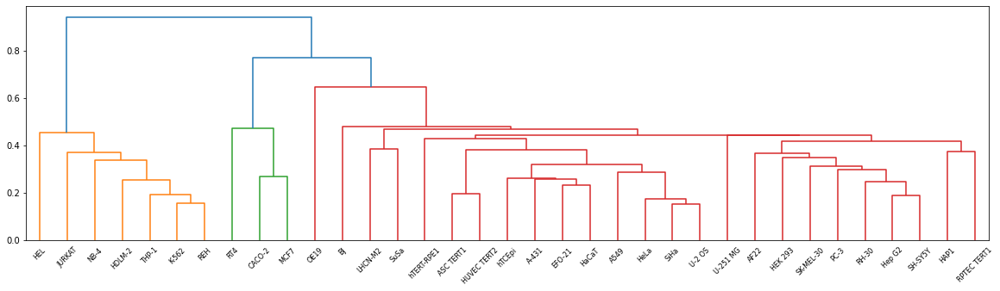

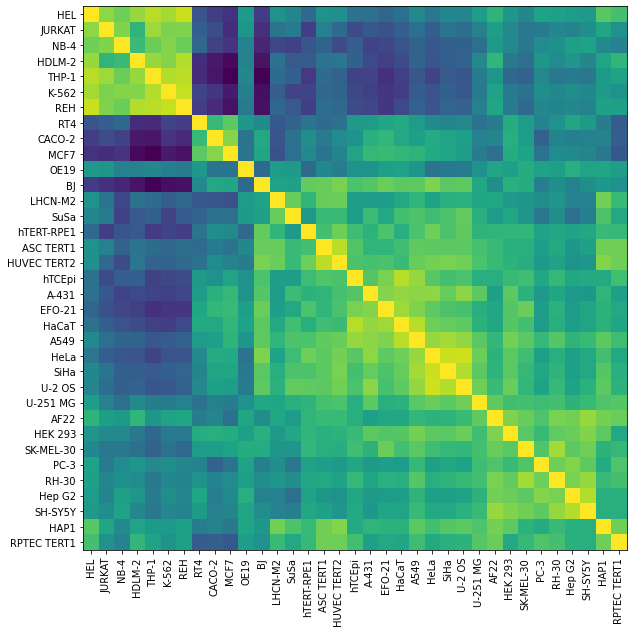

In [148]:
distance_matrix, columns = get_heirarchical_clustering(df, features, ['cell_type'])

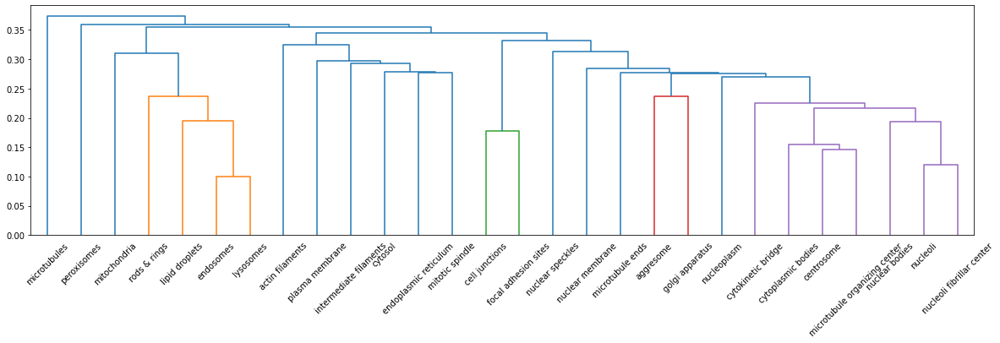

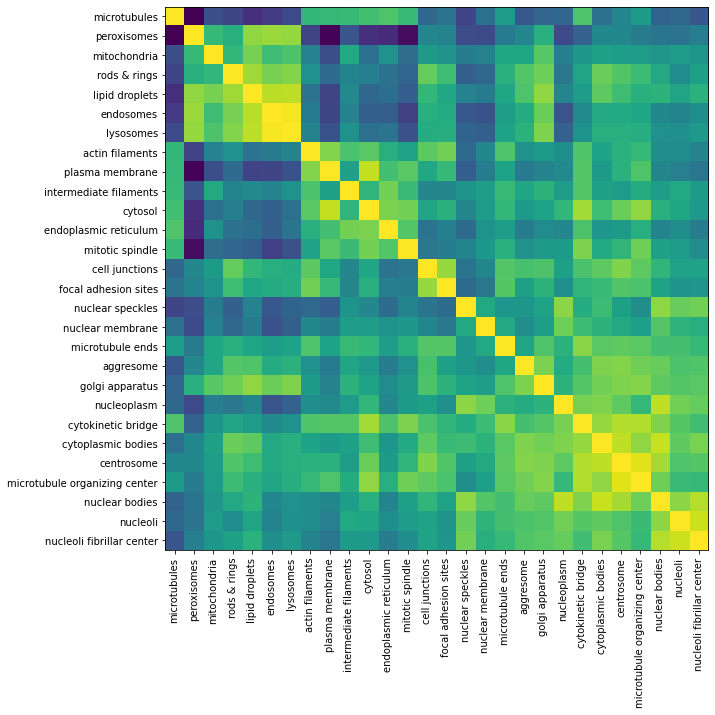

In [149]:
labels = protein_to_num_single_cells
labels = protein_to_num_full
distance_matrix, columns = get_heirarchical_clustering(df, features, protein_to_num_full)


### Generate UMAP

In [1004]:
embedding = get_embeddings(features)

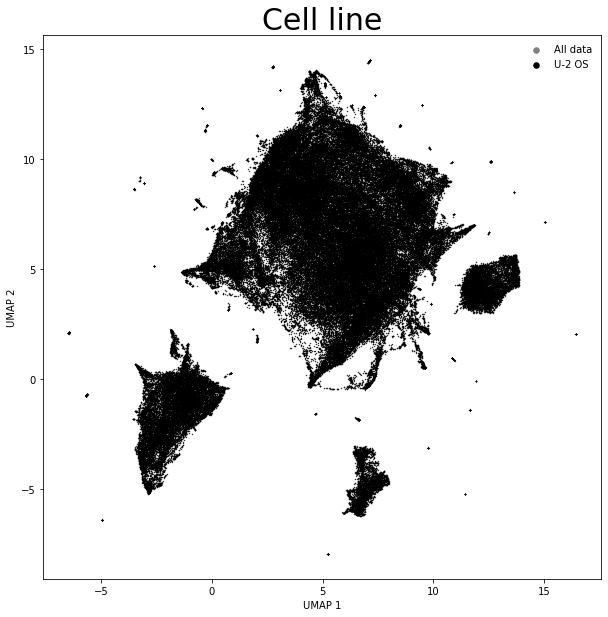

In [1014]:
plot_UMAP(df, ['cell_type'], embedding, 'Cell line')

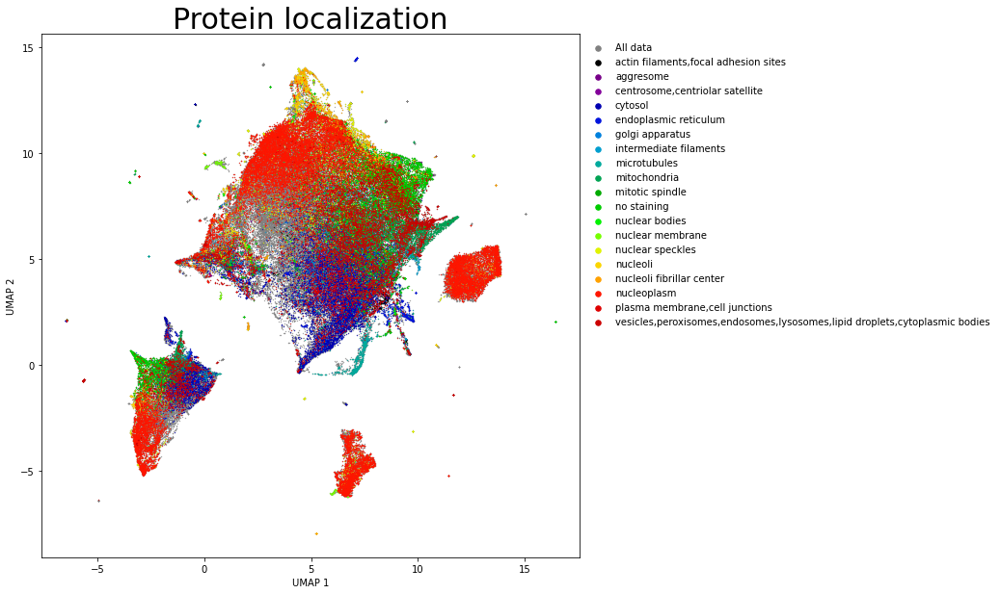

In [1015]:
plot_UMAP(df, protein_to_num_single_cells, embedding, 'Protein localization')

# Explore single cell heterogeneity

### Hypothesis #1: Heterogeneous genes lead to single cell features that are more wide apart, per whole image, compared to homogeneous genes (mean distance)

### Hypothesis #2: Heterogeneous genes lead to single cell features that are more wide apart, per whole image, compared to homogeneous genes (standard deviation)

### TODO: Hypothesis #3: Heterogeneous genes lead to more diverse classification labels compared to homogeneous genes

##### (Issue: This depends on classifier training quality, which is one step removed from feature quality)

### TODO: Plot kaggle performance comparison

### TODO: Plot protein-protein interactions

## Generate all figures

/scr/mdoron/miniconda3/lib/python3.9/site-packages/scipy/stats/stats.py:129: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  a = np.asarray(a)
/scr/mdoron/miniconda3/lib/python3.9/site-packages/scipy/stats/stats.py:130: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  b = np.asarray(b)
/scr/mdoron/miniconda3/lib/python3.9/site-packages/scipy/stats/stats.py:99: RuntimeWarning: The input array could not be properly checked for nan values. nan values will be ignored.
  warnings.warn("The input array could not be properly "


TypeError: unsupported operand type(s) for /: 'list' and 'int'

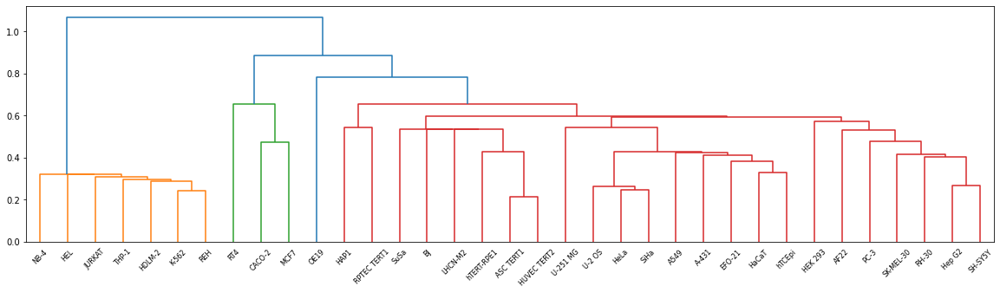

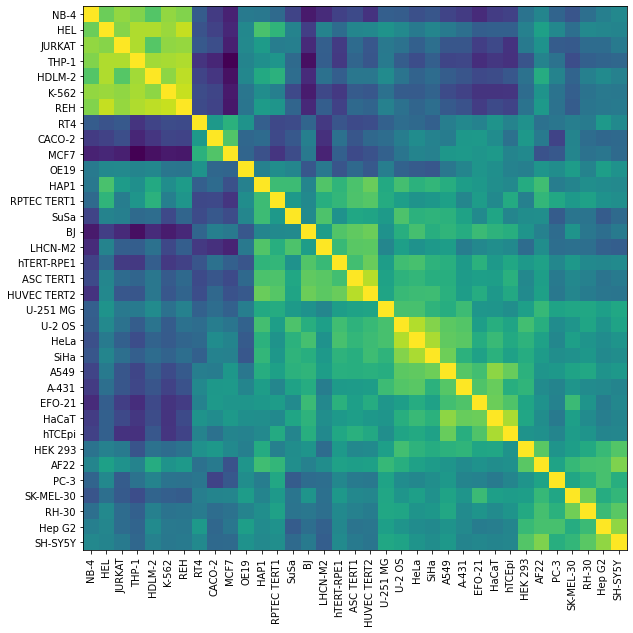

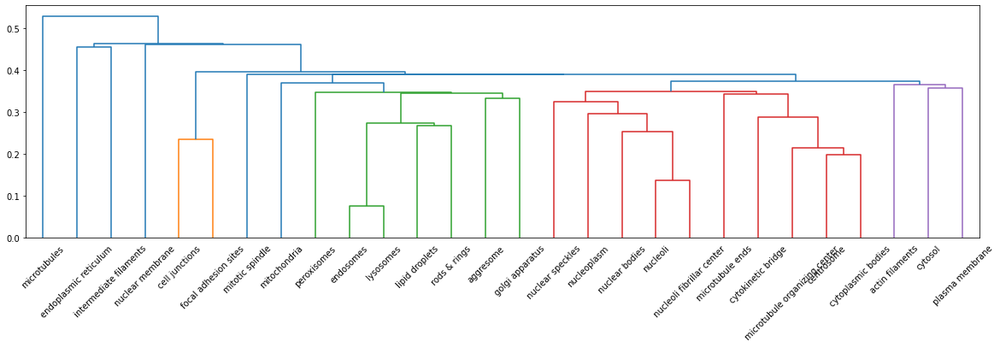

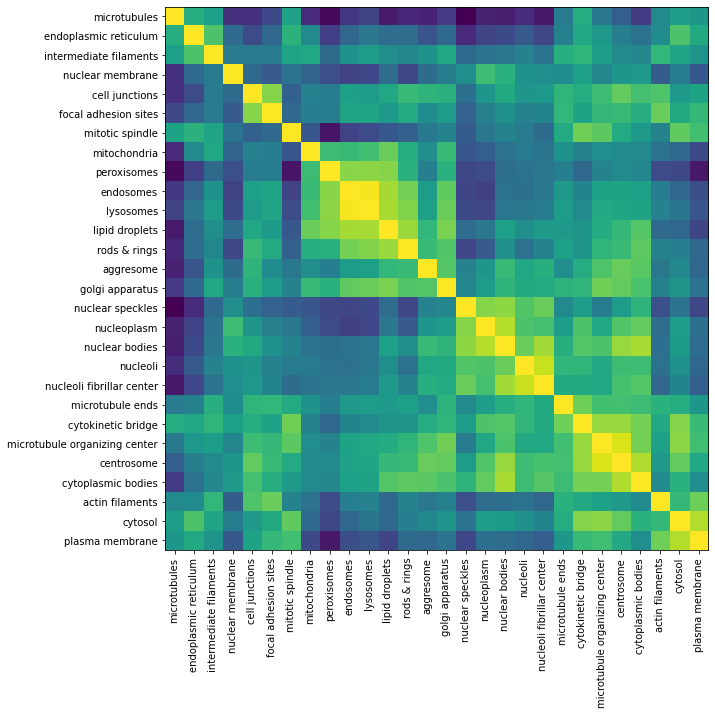

ValueError: On entry to DHSEQR parameter number 4 had an illegal value

<Figure size 720x720 with 1 Axes>

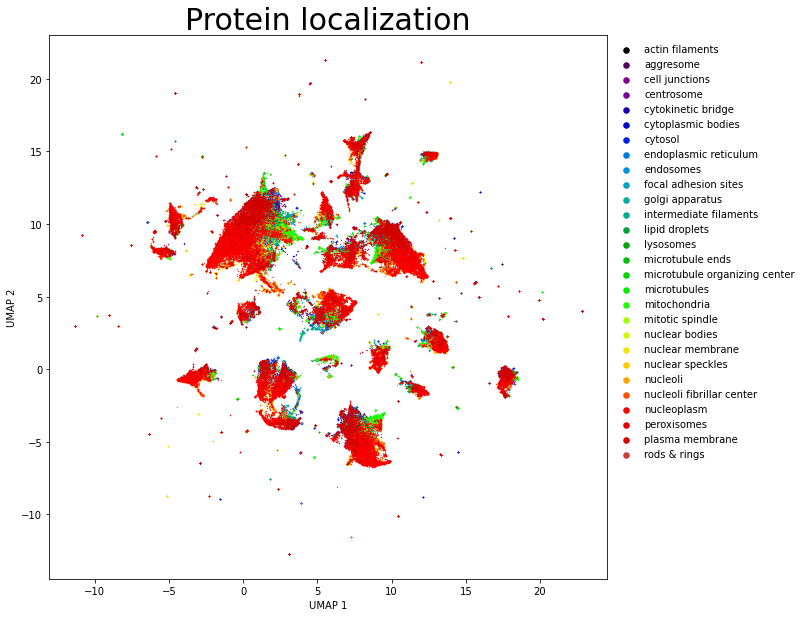

In [139]:
# generate_all_figures('/scr/mdoron/Dino4Cells/configs/config_varied_masked_no_norm_vit_base_HPA.yaml', 
#                      labels = protein_to_num_single_cells)
# generate_all_figures('/scr/mdoron/Dino4Cells/configs/config_FAIR_whole_image_all_channels.yaml', 
#                      labels = protein_to_num_full)
generate_all_figures('/scr/mdoron/Dino4Cells/configs/config_U-2_OS_0.998.yaml', 
                     labels = protein_to_num_single_cells)


In [ ]:
config_file = '/scr/mdoron/Dino4Cells/configs/config_hpa_single_cell_4_channels.yaml'
config = yaml.safe_load(open(config_file, "r"))
df = pd.read_csv(config['embedding']['df_path'])
features, protein_localizations, cell_lines, IDs = torch.load(config['embedding']['output_path'])    


In [7]:
embedding = get_embeddings(features)  

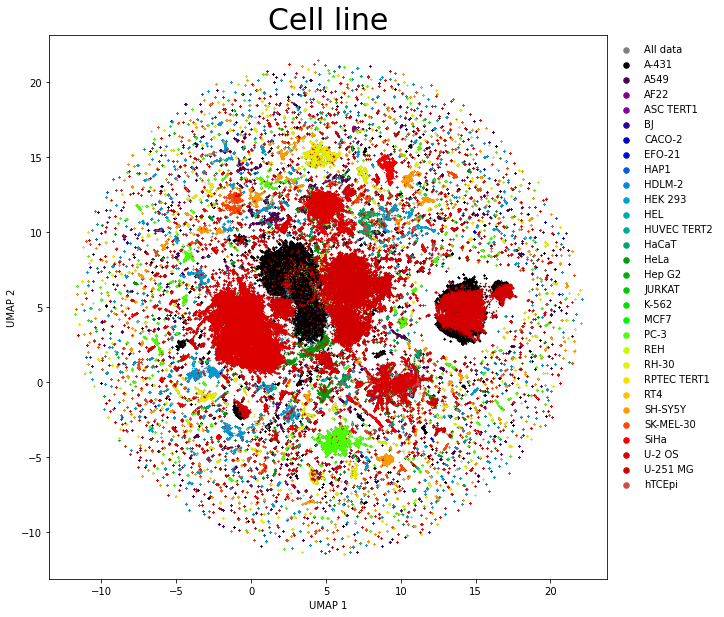

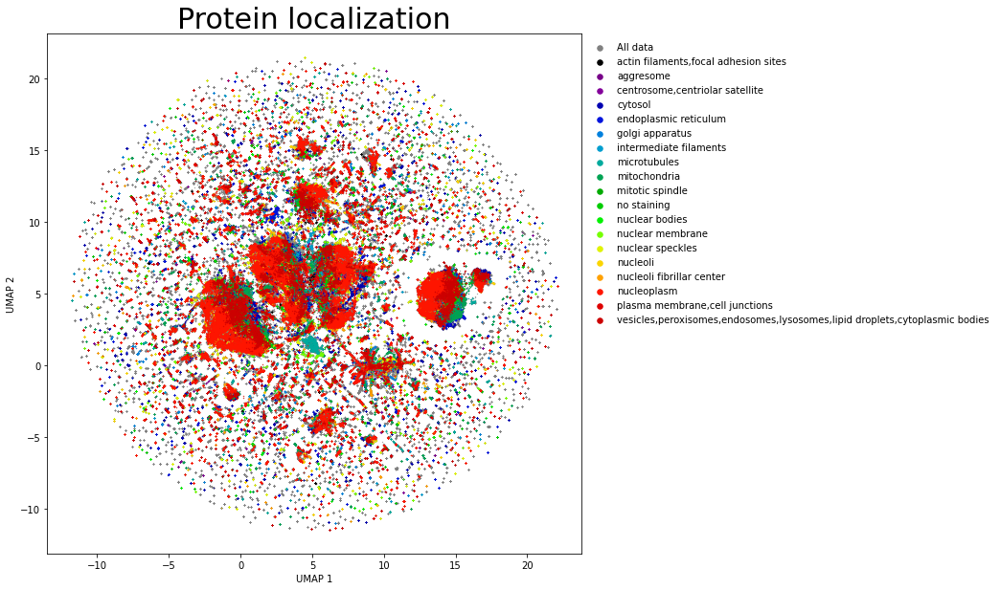

In [9]:
plot_UMAP(df, ['cell_type'], embedding, 'Cell line')
plot_UMAP(df, protein_to_num_single_cells, embedding, 'Protein localization')


In [ ]:
config_file = '/scr/mdoron/Dino4Cells/configs/config_varied_masked_no_norm_vit_base_HPA.yaml'
config = yaml.safe_load(open(config_file, "r"))
df = pd.read_csv(config['embedding']['df_path'])
features, protein_localizations, cell_lines, IDs = torch.load(config['embedding']['output_path'])    
embedding = get_embeddings(features)  


In [ ]:
proto_heterogeneity_df

In [8]:
heterogeneity_df = get_heterogeneity_df()

In [9]:
heterogeneity_df

,Gene,ID,v_spatial,v_intensity,HPA_variable,cell_type
0,ENSG00000000003,4109_23_H11_1,False,True,True,U-2 OS
1,ENSG00000000003,4109_23_H11_2,False,True,True,U-2 OS
2,ENSG00000000003,4109_23_H11_2,False,True,True,U-2 OS
3,ENSG00000000003,4109_23_H11_2,False,True,True,U-2 OS
4,ENSG00000000457,5624_91_H11_1,False,False,NaN,U-2 OS
...,...,...,...,...,...,...
135730,ENSG00000285458,57434_1300_A5_2,False,False,NaN,U-2 OS
135731,ENSG00000285458,57434_1300_A5_2,False,False,NaN,U-2 OS
135732,ENSG00000285458,57434_1300_A5_2,False,False,NaN,U-2 OS
135733,ENSG00000285458,57434_1300_A5_2,False,False,NaN,U-2 OS


In [56]:
config_file = 'configs/config_U-2_OS_0.998.yaml'
config = yaml.safe_load(open(config_file, "r"))
df = pd.read_csv(config['embedding']['df_path'])    
features, protein_localizations, cell_lines, IDs = torch.load(config['embedding']['output_path'])    
heterogeneity_df = get_heterogeneity_df()
heterogeneity_key = 'v_spatial'
heterogeneous_indices = np.where(df.ID.isin(heterogeneity_df[heterogeneity_df[heterogeneity_key]].ID))[0]
homogeneous_indices = np.where(df.ID.isin(heterogeneity_df[heterogeneity_df[heterogeneity_key]].ID) == False)[0]
scaled_features = StandardScaler().fit_transform(features.numpy())
mean_distances_hetero = get_heterogeneousity_per_whole_image(df, scaled_features, heterogeneous_indices, metric='distance', verbose=False)
mean_distances_homo = get_heterogeneousity_per_whole_image(df, scaled_features, homogeneous_indices, metric='distance', verbose=False)
mean_stds_hetero = get_heterogeneousity_per_whole_image(df, scaled_features, heterogeneous_indices, metric='std', verbose=False)
mean_stds_homo = get_heterogeneousity_per_whole_image(df, scaled_features, homogeneous_indices, metric='std', verbose=False)


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 16055/16055 [02:59<00:00, 89.68it/s]


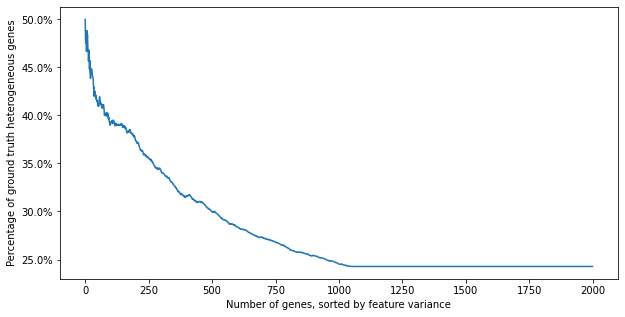

In [232]:
config_file = 'configs/config_U-2_OS_0.998.yaml'
config = yaml.safe_load(open(config_file, "r"))
df = pd.read_csv(config['embedding']['df_path'])    
features, protein_localizations, cell_lines, IDs = torch.load(config['embedding']['output_path'])    

heterogeneity_df = get_heterogeneity_df(config_file)
merged_df = pd.merge(heterogeneity_df, df, on='ID', how='right').drop_duplicates()
merged_df.loc[pd.isnull(merged_df['Gene']),'Gene'] = ''
merged_df = merged_df.reset_index()
merged_df['original_index'] = merged_df.index.values
merged_df['cell_type'] = merged_df.cell_type_x
original_indices = merged_df.original_index.values
gene_to_ind = merged_df[['Gene','original_index']].groupby('Gene').groups
gene_to_ind = {k : original_indices[gene_to_ind[k]] for k in gene_to_ind.keys()}
merged_df[pd.isnull(merged_df.Gene)].Gene = ''

mean_stds, sorted_genes = get_heterogeneousity_per_gene(merged_df, scaled_features, indices, metric='std', verbose=False)

enrichment = []
for ind in tqdm(range(100, len(merged_df), 10)):
    enrichment.append(pd.DataFrame(genes_sorted[:ind])[0].isin(merged_df[merged_df.HPA_variable == True].Gene.unique()).values.mean())


import matplotlib.ticker as mtick

fig, ax = plt.subplots(1,1,figsize=(10,5))
ax.plot(enrichment[:2000])
ax.set_xlabel('Number of genes, sorted by feature variance')
ax.set_ylabel('Percentage of ground truth heterogeneous genes')
ax.yaxis.set_major_formatter(mtick.PercentFormatter(1.0))



In [241]:
config_file = '/scr/mdoron/Dino4Cells/configs/config_varied_masked_no_norm_vit_base_HPA.yaml'
config = yaml.safe_load(open(config_file, "r"))
df = pd.read_csv(config['embedding']['df_path'])    
features, protein_localizations, cell_lines, IDs = torch.load(config['embedding']['output_path'])    


In [1248]:
config_file = '/scr/mdoron/Dino4Cells/configs/config_U-2_OS_0.998.yaml'


In [1341]:
images_sorted[0]

'29501_283_B10_1'

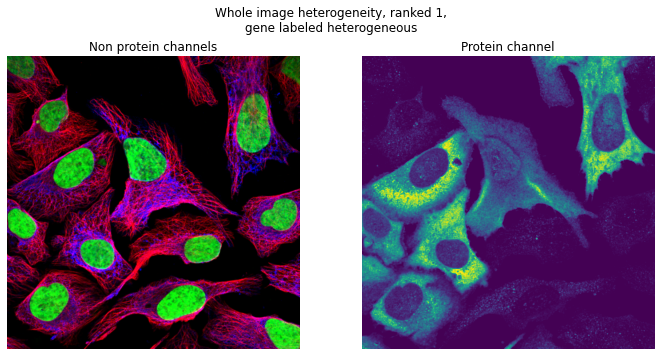

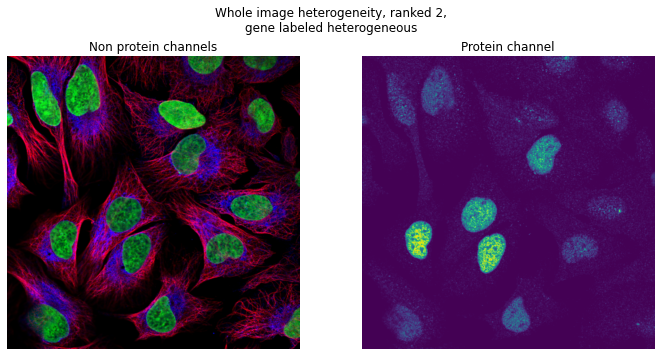

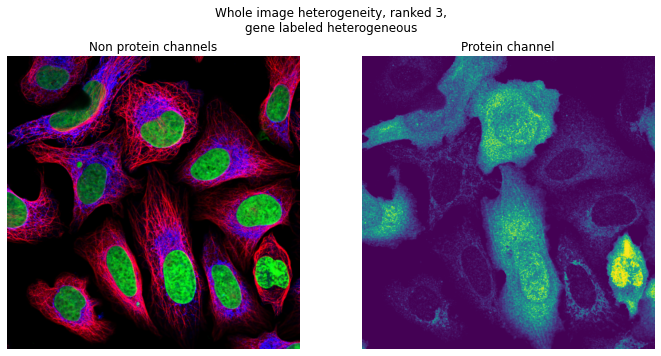

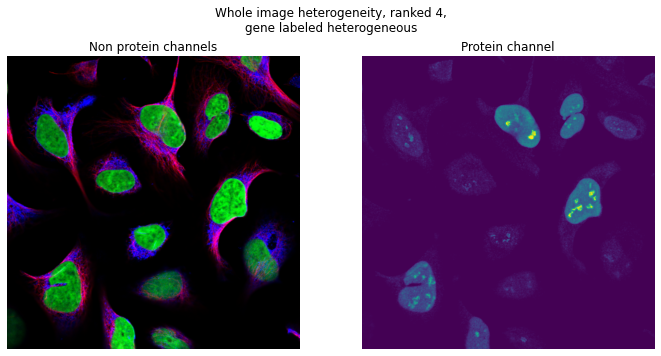

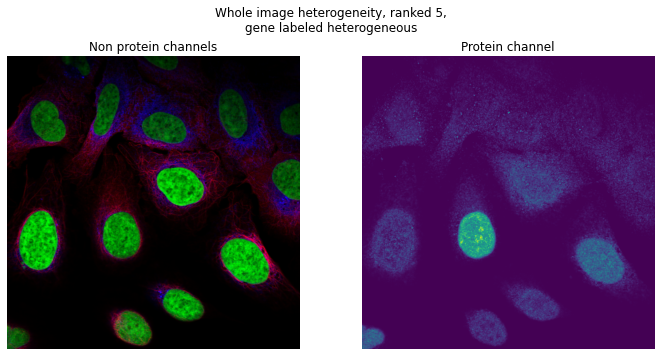

...

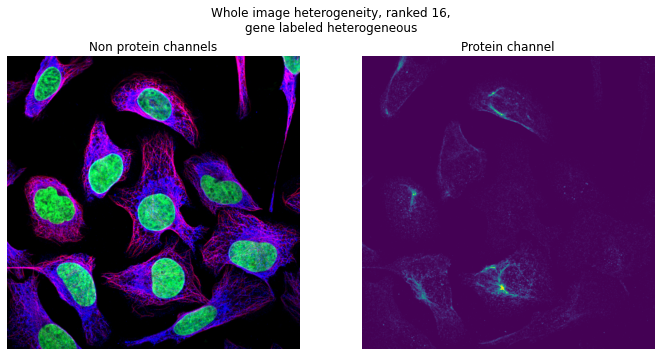

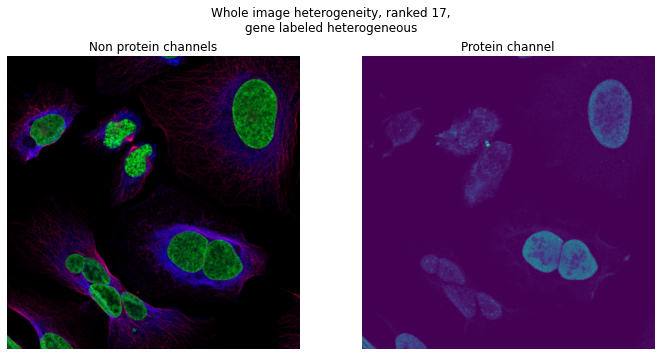

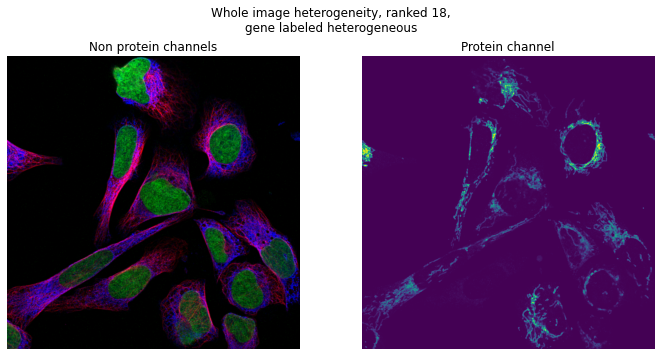

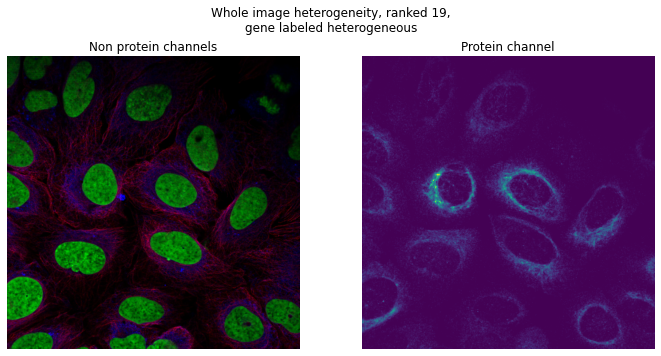

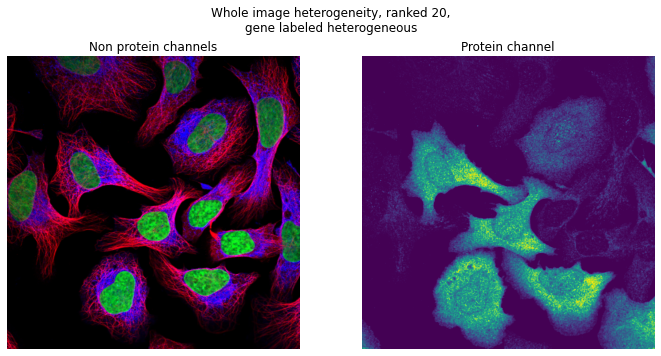

In [1336]:
for image_rank in range(20):
    gene_type = 'heterogeneous' if U2_OS_merged_df[U2_OS_merged_df.ID == images_sorted[image_rank]].HPA_variable.iloc[0] == True else 'unlabeled'
    img = io.imread(f'/scr/mdoron/Dino4Cells/data/whole_images/{U2_OS_merged_df[U2_OS_merged_df.ID == images_sorted[image_rank]].ID.iloc[0]}.png')
    fig, axes = plt.subplots(1,2,figsize=(10,5))
    axes[0].imshow(img[:,:,[0,2,3]])
    axes[0].axis(False)
    axes[1].imshow(img[:,:,[1]])
    axes[1].axis(False)
    axes[0].set_title('Non protein channels')
    axes[1].set_title('Protein channel')
    plt.suptitle(f'Whole image heterogeneity, ranked {image_rank + 1},\ngene labeled {gene_type}')
    plt.tight_layout()


In [1342]:
merged_df['image_rank'] = merged_df.ID.map(dict(zip(images_sorted, range(len(images_sorted)))))

In [1343]:
sorted(merged_df[merged_df['HPA_variable'] != True]['image_rank'].unique())

[20.0,
 33.0,
 40.0,
 42.0,
 49.0,
 61.0,
 65.0,
 74.0,
 77.0,
 83.0,
 102.0,
 103.0,
 111.0,
 123.0,
 133.0,
 144.0,
 150.0,
 154.0,
 159.0,
 175.0,
 177.0,
 190.0,
 195.0,
 196.0,
 197.0,
 205.0,
 215.0,
 217.0,
 222.0,
 237.0,
 240.0,
 242.0,
 248.0,
 256.0,
 270.0,
 274.0,
 278.0,
 282.0,
 287.0,
 297.0,
 299.0,
 301.0,
 308.0,
 309.0,
 312.0,
 322.0,
 324.0,
 326.0,
 328.0,
 329.0,
 332.0,
 335.0,
 336.0,
 337.0,
 338.0,
 339.0,
 340.0,
 342.0,
 345.0,
 346.0,
 347.0,
 348.0,
 350.0,
 354.0,
 357.0,
 358.0,
 374.0,
 381.0,
 382.0,
 384.0,
 395.0,
 399.0,
 402.0,
 404.0,
 407.0,
 408.0,
 414.0,
 416.0,
 417.0,
 421.0,
 423.0,
 427.0,
 430.0,
 431.0,
 434.0,
 443.0,
 445.0,
 447.0,
 448.0,
 449.0,
 451.0,
 452.0,
 453.0,
 456.0,
 457.0,
 458.0,
 459.0,
 469.0,
 470.0,
 474.0,
 475.0,
 476.0,
 478.0,
 482.0,
 485.0,
 487.0,
 489.0,
 493.0,
 494.0,
 498.0,
 504.0,
 505.0,
 507.0,
 508.0,
 510.0,
 511.0,
 516.0,
 517.0,
 525.0,
 528.0,
 529.0,
 533.0,
 536.0,
 542.0,
 543.0,
 547.0,
 5

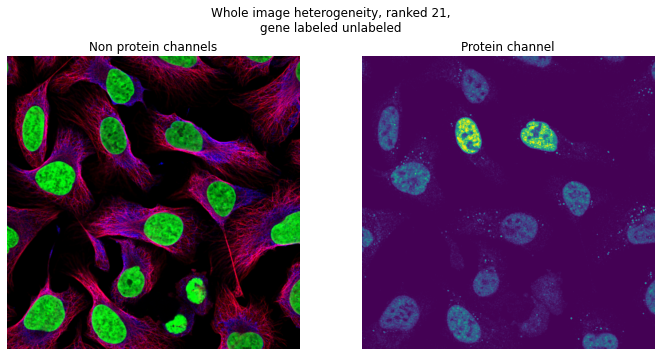

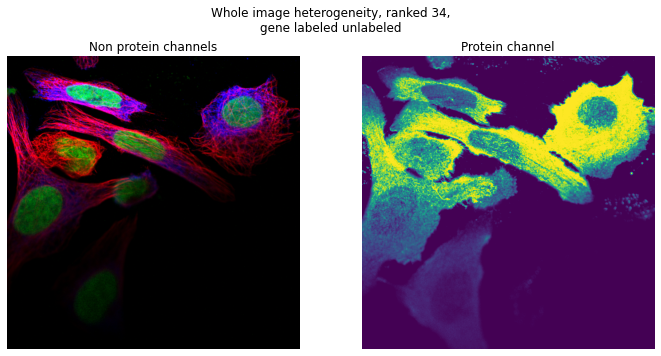

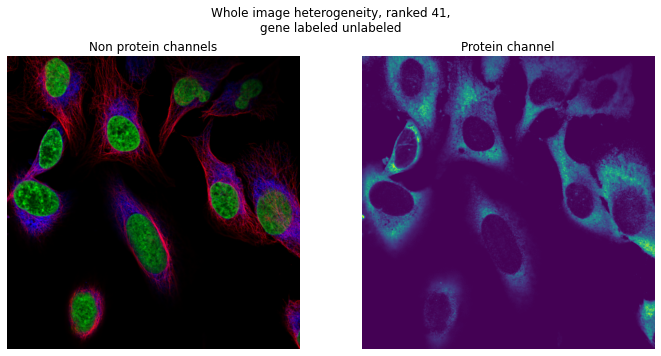

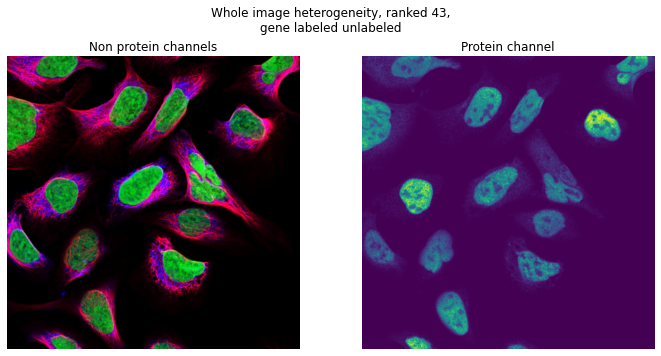

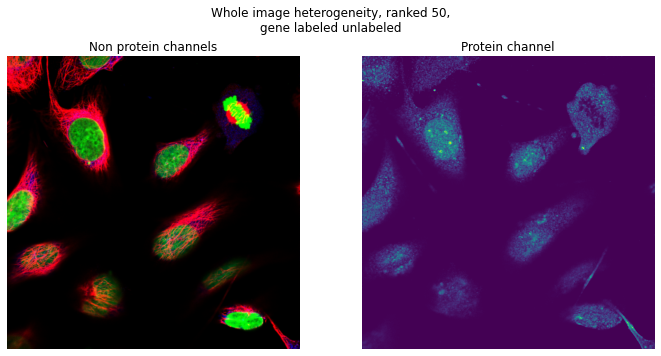

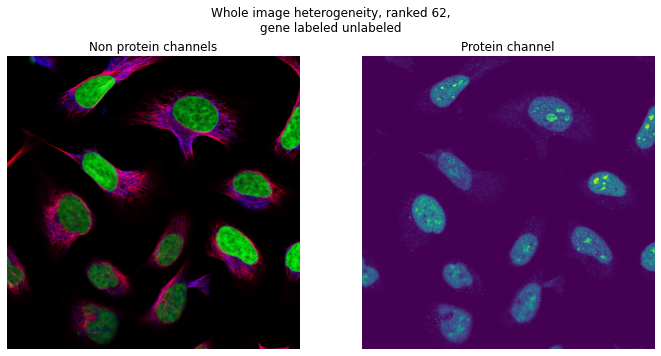

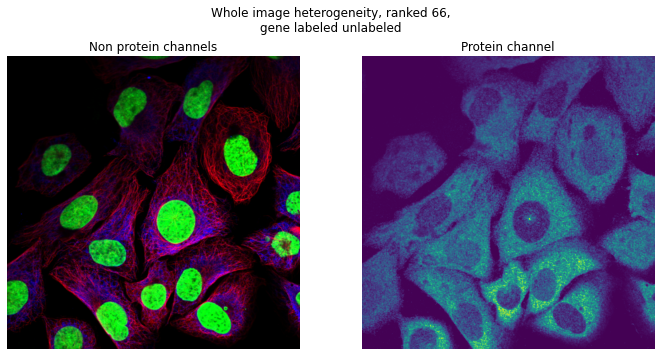

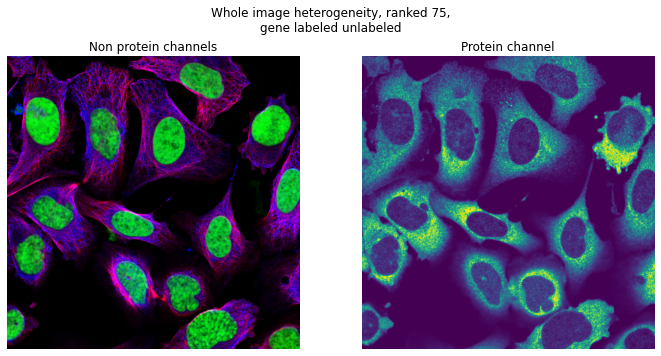

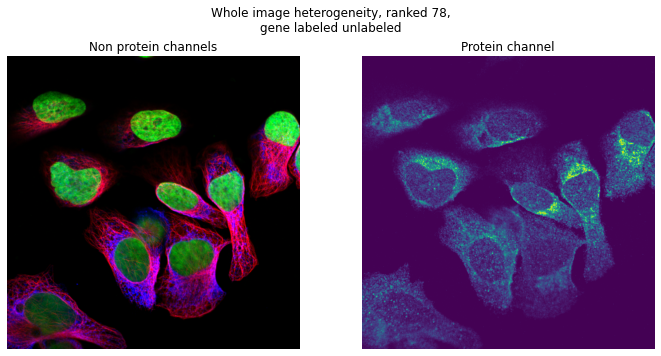

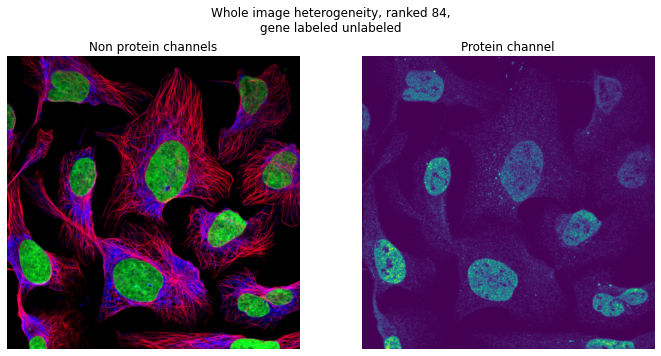

In [1346]:
for image_rank in np.array(sorted(merged_df[merged_df['HPA_variable'] != True]['image_rank'].unique())[:10]).astype(int):
    gene_type = 'heterogeneous' if U2_OS_merged_df[U2_OS_merged_df.ID == images_sorted[image_rank]].HPA_variable.iloc[0] == True else 'unlabeled'
    img = io.imread(f'/scr/mdoron/Dino4Cells/data/whole_images/{U2_OS_merged_df[U2_OS_merged_df.ID == images_sorted[image_rank]].ID.iloc[0]}.png')
    fig, axes = plt.subplots(1,2,figsize=(10,5))
    axes[0].imshow(img[:,:,[0,2,3]])
    axes[0].axis(False)
    axes[1].imshow(img[:,:,[1]])
    axes[1].axis(False)
    axes[0].set_title('Non protein channels')
    axes[1].set_title('Protein channel')
    plt.suptitle(f'Whole image heterogeneity, ranked {image_rank + 1},\ngene labeled {gene_type}')
    plt.tight_layout()


In [1350]:
image_enrichments

NameError: name 'full_enrichments_image' is not defined

Text(0.5, 1.0, 'Comparison between min and mean image rank')

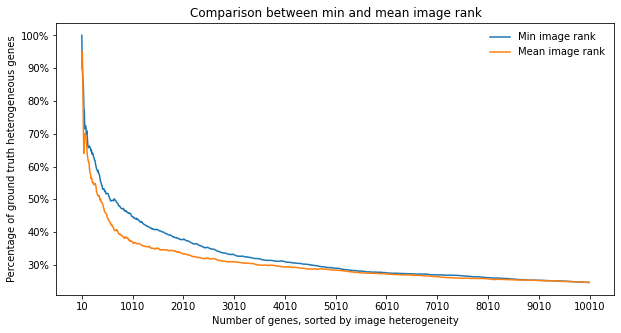

In [1355]:

fig, ax = plt.subplots(1,1,figsize=(10,5), facecolor='white')
plt.plot(image_enrichments[0][:1000], label='Min image rank')
plt.plot(mean_enrichments_image[0][:1000], label='Mean image rank')
plt.legend(frameon=False)
ax.set_xlabel('Number of genes, sorted by image heterogeneity')
ax.set_ylabel('Percentage of ground truth heterogeneous genes')
ax.yaxis.set_major_formatter(mtick.PercentFormatter(1.0))
plt.xticks(list(range(0, int((len(genes_sorted) - 10) / 10), 100)), 
           list(range(10, len(genes_sorted), 1000)))
print('')
plt.title('Comparison between min and mean image rank')


In [1348]:
mean_enrichments_image = []
for config_file in [
                    '/scr/mdoron/Dino4Cells/configs/config_U-2_OS_0.998.yaml', 
                    '/scr/mdoron/Dino4Cells/configs/config_varied_masked_no_norm_vit_base_HPA.yaml',
                    '/scr/mdoron/Dino4Cells/configs/config_pretrained.yaml',
                    '/scr/mdoron/Dino4Cells/configs/config_tta.yaml',
                   ]:
    mean_enrichments_image.append(find_image_enrichment(config_file, heterogenous_type = 'HPA_variable', image_criterion='mean'))


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1056/1056 [00:08<00:00, 117.87it/s]


In [1316]:
full_enrichments = []
v_spatial_enrichments = []
v_intensity_enrichments = []
full_enrichments_image = []
v_spatial_enrichments_image = []
v_intensity_enrichments_image = []
for config_file in [
                    '/scr/mdoron/Dino4Cells/configs/config_U-2_OS_0.998.yaml', 
                    '/scr/mdoron/Dino4Cells/configs/config_varied_masked_no_norm_vit_base_HPA.yaml',
                    '/scr/mdoron/Dino4Cells/configs/config_pretrained.yaml',
                    '/scr/mdoron/Dino4Cells/configs/config_tta.yaml',
                   ]:
    full_enrichments.append(find_gene_enrichment(config_file, heterogenous_type = 'HPA_variable'))
    v_spatial_enrichments.append(find_gene_enrichment(config_file, heterogenous_type = 'v_spatial'))
    v_intensity_enrichments.append(find_gene_enrichment(config_file, heterogenous_type = 'v_intensity'))
    full_enrichments_image.append(find_image_enrichment(config_file, heterogenous_type = 'HPA_variable'))
    v_spatial_enrichments_image.append(find_image_enrichment(config_file, heterogenous_type = 'v_spatial'))
    v_intensity_enrichments_image.append(find_image_enrichment(config_file, heterogenous_type = 'v_intensity'))
    

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1056/1056 [00:11<00:00, 91.79it/s]


Text(0.5, 1.0, 'Heterogeneous gene ranking (intensity heterogeneity)')

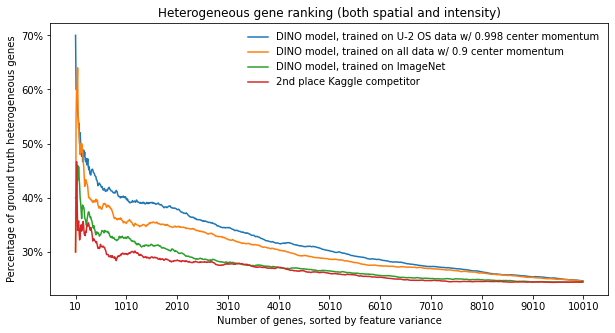

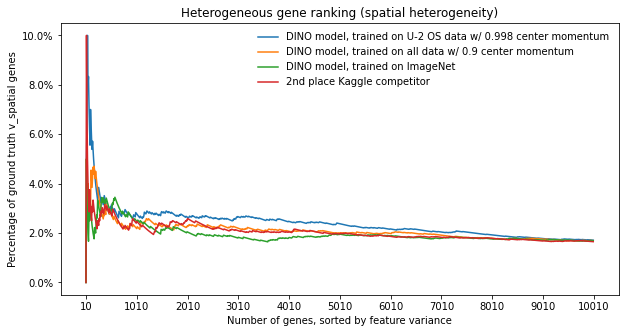

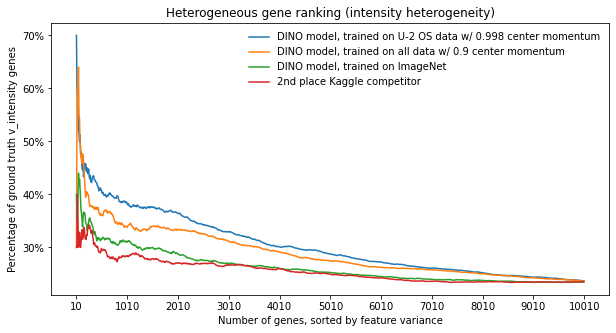

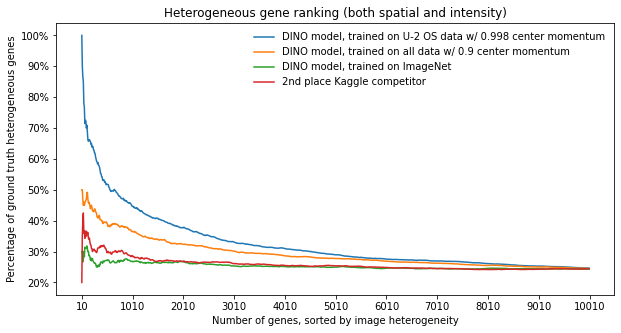

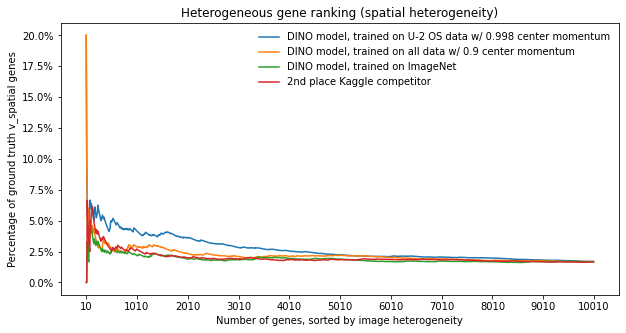

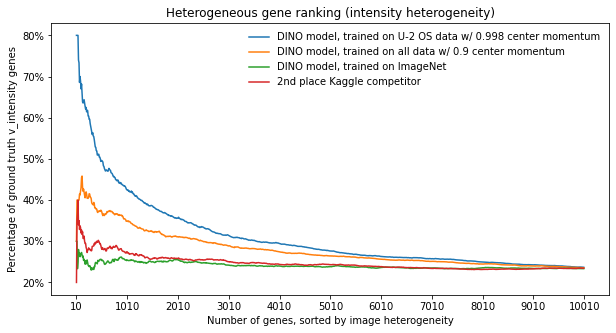

In [1331]:
fig, ax = plt.subplots(1,1,figsize=(10,5), facecolor='white')
labels = [
          'DINO model, trained on U-2 OS data w/ 0.998 center momentum',
          'DINO model, trained on all data w/ 0.9 center momentum',
          'DINO model, trained on ImageNet',
          '2nd place Kaggle competitor',
         ]
for ind, label in enumerate(labels):
    plt.plot(full_enrichments[ind][:1000], label=label)
plt.legend(frameon=False)
ax.set_xlabel('Number of genes, sorted by feature variance')
ax.set_ylabel('Percentage of ground truth heterogeneous genes')
ax.yaxis.set_major_formatter(mtick.PercentFormatter(1.0))
plt.xticks(list(range(0, int((len(genes_sorted) - 10) / 10), 100)), 
           list(range(10, len(genes_sorted), 1000)))
print('')
plt.title('Heterogeneous gene ranking (both spatial and intensity)')

fig, ax = plt.subplots(1,1,figsize=(10,5), facecolor='white')
for ind, label in enumerate(labels):
    plt.plot(v_spatial_enrichments[ind][:1000], label=label)
plt.legend(frameon=False)
ax.set_xlabel('Number of genes, sorted by feature variance')
ax.set_ylabel('Percentage of ground truth v_spatial genes')
ax.yaxis.set_major_formatter(mtick.PercentFormatter(1.0))
plt.xticks(list(range(0, int((len(genes_sorted) - 10) / 10), 100)), 
           list(range(10, len(genes_sorted), 1000)))
print('')
plt.title('Heterogeneous gene ranking (spatial heterogeneity)')


fig, ax = plt.subplots(1,1,figsize=(10,5), facecolor='white')
for ind, label in enumerate(labels):
    plt.plot(v_intensity_enrichments[ind][:1000], label=label)
plt.legend(frameon=False)
ax.set_xlabel('Number of genes, sorted by feature variance')
ax.set_ylabel('Percentage of ground truth v_intensity genes')
ax.yaxis.set_major_formatter(mtick.PercentFormatter(1.0))
plt.xticks(list(range(0, int((len(genes_sorted) - 10) / 10), 100)), 
           list(range(10, len(genes_sorted), 1000)))
print('')
plt.title('Heterogeneous gene ranking (intensity heterogeneity)')




fig, ax = plt.subplots(1,1,figsize=(10,5), facecolor='white')
labels = [
          'DINO model, trained on U-2 OS data w/ 0.998 center momentum',
          'DINO model, trained on all data w/ 0.9 center momentum',
          'DINO model, trained on ImageNet',
          '2nd place Kaggle competitor',
         ]
for ind, label in enumerate(labels):
    plt.plot(image_enrichments[ind][:1000], label=label)
plt.legend(frameon=False)
ax.set_xlabel('Number of genes, sorted by image heterogeneity')
ax.set_ylabel('Percentage of ground truth heterogeneous genes')
ax.yaxis.set_major_formatter(mtick.PercentFormatter(1.0))
plt.xticks(list(range(0, int((len(genes_sorted) - 10) / 10), 100)), 
           list(range(10, len(genes_sorted), 1000)))
print('')
plt.title('Heterogeneous gene ranking (both spatial and intensity)')

fig, ax = plt.subplots(1,1,figsize=(10,5), facecolor='white')
for ind, label in enumerate(labels):
    plt.plot(v_spatial_enrichments_image[ind][:1000], label=label)
plt.legend(frameon=False)
ax.set_xlabel('Number of genes, sorted by image heterogeneity')
ax.set_ylabel('Percentage of ground truth v_spatial genes')
ax.yaxis.set_major_formatter(mtick.PercentFormatter(1.0))
plt.xticks(list(range(0, int((len(genes_sorted) - 10) / 10), 100)), 
           list(range(10, len(genes_sorted), 1000)))
print('')
plt.title('Heterogeneous gene ranking (spatial heterogeneity)')


fig, ax = plt.subplots(1,1,figsize=(10,5), facecolor='white')
for ind, label in enumerate(labels):
    plt.plot(v_intensity_enrichments_image[ind][:1000], label=label)
plt.legend(frameon=False)
ax.set_xlabel('Number of genes, sorted by image heterogeneity')
ax.set_ylabel('Percentage of ground truth v_intensity genes')
ax.yaxis.set_major_formatter(mtick.PercentFormatter(1.0))
plt.xticks(list(range(0, int((len(genes_sorted) - 10) / 10), 100)), 
           list(range(10, len(genes_sorted), 1000)))
print('')
plt.title('Heterogeneous gene ranking (intensity heterogeneity)')


In [230]:
config_file = '/scr/mdoron/Dino4Cells/configs/config_varied_masked_no_norm_vit_base_HPA.yaml'
config = yaml.safe_load(open(config_file, "r"))
df = pd.read_csv(config['embedding']['df_path'])    
features, protein_localizations, cell_lines, IDs = torch.load(config['embedding']['output_path'])    

heterogeneity_df = get_heterogeneity_df(config_file)
merged_df = pd.merge(heterogeneity_df, df, on='ID', how='right').drop_duplicates()
merged_df.loc[pd.isnull(merged_df['Gene']),'Gene'] = ''
merged_df = merged_df.reset_index()
merged_df['original_index'] = merged_df.index.values
merged_df['cell_type'] = merged_df.cell_type_x
original_indices = merged_df.original_index.values
gene_to_ind = merged_df[['Gene','original_index']].groupby('Gene').groups
gene_to_ind = {k : original_indices[gene_to_ind[k]] for k in gene_to_ind.keys()}
merged_df[pd.isnull(merged_df.Gene)].Gene = ''


,index,Gene,ID,v_spatial,v_intensity,HPA_variable,cell_type_x,file,nucleoplasm,nuclear membrane,...,"plasma membrane,cell junctions",mitochondria,aggresome,cytosol,"vesicles,peroxisomes,endosomes,lysosomes,lipid droplets,cytoplasmic bodies",no staining,protein_location,cell_type_y,original_index,cell_type
0,0,ENSG00000141522,10005_921_B9_1,False,False,NaN,A-431,/scr/mdoron/Dino4Cells/data/fixed_size_masked_...,False,False,...,False,False,False,True,False,False,['cytosol'],A-431,0,A-431
1,13,ENSG00000141522,10005_921_B9_1,False,False,NaN,A-431,/scr/mdoron/Dino4Cells/data/fixed_size_masked_...,False,False,...,False,False,False,True,False,False,['cytosol'],A-431,1,A-431
2,26,ENSG00000141522,10005_921_B9_1,False,False,NaN,A-431,/scr/mdoron/Dino4Cells/data/fixed_size_masked_...,False,False,...,False,False,False,True,False,False,['cytosol'],A-431,2,A-431
3,39,ENSG00000141522,10005_921_B9_1,False,False,NaN,A-431,/scr/mdoron/Dino4Cells/data/fixed_size_masked_...,False,False,...,False,False,False,True,False,False,['cytosol'],A-431,3,A-431
4,52,ENSG00000141522,10005_921_B9_1,False,False,NaN,A-431,/scr/mdoron/Dino4Cells/data/fixed_size_masked_...,False,False,...,False,False,False,True,False,False,['cytosol'],A-431,4,A-431
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1134880,12844170,,dea19dc6-bbca-11e8-b2bc-ac1f6b6435d0,NaN,NaN,NaN,NaN,/scr/mdoron/Dino4Cells/data/fixed_size_masked_...,True,False,...,False,False,False,False,False,False,"['nuclear bodies', 'nucleoplasm']",MCF7,1134880,NaN
1134881,12844171,,dea19dc6-bbca-11e8-b2bc-ac1f6b6435d0,NaN,NaN,NaN,NaN,/scr/mdoron/Dino4Cells/data/fixed_size_masked_...,True,False,...,False,False,False,False,False,False,"['nuclear bodies', 'nucleoplasm']",MCF7,1134881,NaN
1134882,12844172,,dea19dc6-bbca-11e8-b2bc-ac1f6b6435d0,NaN,NaN,NaN,NaN,/scr/mdoron/Dino4Cells/data/fixed_size_masked_...,True,False,...,False,False,False,False,False,False,"['nuclear bodies', 'nucleoplasm']",MCF7,1134882,NaN
1134883,12844173,,dea19dc6-bbca-11e8-b2bc-ac1f6b6435d0,NaN,NaN,NaN,NaN,/scr/mdoron/Dino4Cells/data/fixed_size_masked_...,True,False,...,False,False,False,False,False,False,"['nuclear bodies', 'nucleoplasm']",MCF7,1134883,NaN


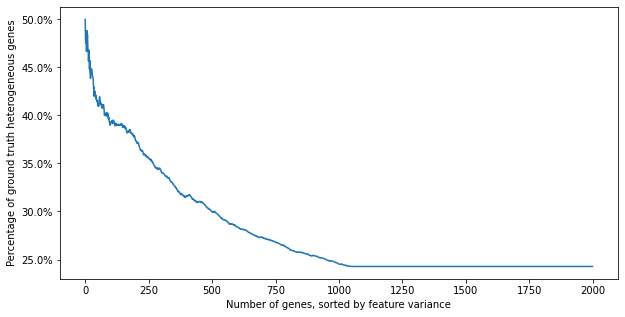

In [169]:
reducer = UMAP(random_state=0, init='random')
scaled_features = StandardScaler().fit_transform(features)
embedding = reducer.fit_transform(scaled_features)


In [1044]:
targets = torch.stack(protein_localizations)

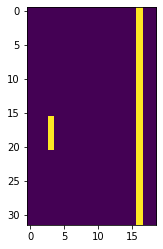

In [1115]:
plt.imshow(gene_df[sorted(list(protein_to_num_single_cells.keys()))].astype(int).values)

In [1512]:
merged_df['rank'] = merged_df.Gene.map(dict(zip(genes_sorted, range(len(genes_sorted)))))


In [1513]:
sorted(merged_df[merged_df['HPA_variable'] != True]['rank'].unique())

[16.0,
 18.0,
 26.0,
 27.0,
 54.0,
 69.0,
 71.0,
 85.0,
 110.0,
 114.0,
 121.0,
 125.0,
 127.0,
 145.0,
 162.0,
 164.0,
 172.0,
 198.0,
 201.0,
 202.0,
 208.0,
 216.0,
 225.0,
 231.0,
 235.0,
 256.0,
 264.0,
 266.0,
 274.0,
 279.0,
 282.0,
 283.0,
 285.0,
 289.0,
 292.0,
 303.0,
 308.0,
 315.0,
 323.0,
 326.0,
 327.0,
 330.0,
 335.0,
 343.0,
 347.0,
 362.0,
 365.0,
 370.0,
 371.0,
 374.0,
 390.0,
 394.0,
 398.0,
 400.0,
 415.0,
 416.0,
 419.0,
 421.0,
 422.0,
 432.0,
 434.0,
 438.0,
 443.0,
 456.0,
 458.0,
 460.0,
 466.0,
 467.0,
 470.0,
 474.0,
 476.0,
 479.0,
 484.0,
 485.0,
 493.0,
 513.0,
 514.0,
 527.0,
 530.0,
 533.0,
 536.0,
 555.0,
 557.0,
 559.0,
 561.0,
 562.0,
 565.0,
 572.0,
 577.0,
 588.0,
 593.0,
 597.0,
 602.0,
 607.0,
 611.0,
 612.0,
 617.0,
 619.0,
 622.0,
 623.0,
 627.0,
 651.0,
 656.0,
 671.0,
 672.0,
 676.0,
 684.0,
 692.0,
 693.0,
 694.0,
 706.0,
 707.0,
 708.0,
 710.0,
 712.0,
 714.0,
 726.0,
 727.0,
 731.0,
 742.0,
 744.0,
 755.0,
 761.0,
 762.0,
 768.0,
 774.0,


In [1456]:
import torch
import pandas as pd
preds = torch.load('/scr/mdoron/Dino4Cells/results/without-norm-varied-masked-mom-0.996-epoch-100_vit_base_HPA/predictions.pth')
preds = torch.stack(preds)
preds = (torch.sigmoid(preds) > 0.5).int().detach().cpu().numpy()
preds = preds[:,0,:]


In [1460]:
import torch
import pandas as pd
preds = torch.load('/scr/mdoron/Dino4Cells/results/without-norm-varied-masked-mom-0.996-epoch-100_vit_base_HPA/predictions.pth')
preds = torch.stack(preds)
preds = (torch.sigmoid(preds) > 0.5).int().detach().cpu().numpy()
preds = preds[:,0,:]
df = pd.read_csv(config['embedding']['df_path'])
cell_indices = np.where(df.cell_type == 'U-2 OS')[0]
cell_preds = preds[cell_indices]
sig_preds = np.array((torch.sigmoid(torch.Tensor(cell_preds)) > 0.5).int()[:,:])

In [1461]:
df = pd.read_csv(config['embedding']['df_path'])    
heterogeneity_df = get_heterogeneity_df(config_file)
merged_df = pd.merge(heterogeneity_df, df, on='ID', how='right').drop_duplicates()
merged_df.loc[pd.isnull(merged_df['Gene']),'Gene'] = ''
merged_df = merged_df.reset_index()
merged_df['original_index'] = merged_df.index.values
merged_df['cell_type'] = merged_df.cell_type_x
original_indices = merged_df.original_index.values
gene_to_ind = merged_df[['Gene','original_index']].groupby('Gene').groups
gene_to_ind = {k : original_indices[gene_to_ind[k]] for k in gene_to_ind.keys()}
merged_df[pd.isnull(merged_df.Gene)].Gene = ''


In [1485]:
gene2uniprot = pd.read_csv('XML_df/HPA_img_df_new.csv')[['gene','uniport_id']].drop_duplicates()
uniprot2name = pd.read_csv('uniport_interactions.tsv', delimiter='\t')[['Entry','Gene Names']].drop_duplicates()
gene2name = pd.merge(uniprot2name, gene2uniprot, right_on='uniport_id', left_on='Entry')[['gene','Gene Names']]

In [14]:
df = pd.read_csv(config['embedding']['df_path'])


In [10]:
a,b,c,d = torch.load('/scr/mdoron/Dino4Cells/old_single_cell_features.pth')

In [19]:
(d == np.array(sorted(d))).shape

(108155,)

In [994]:
config_file = '/scr/mdoron/Dino4Cells/configs/config_whole_image.yaml'
# config_file = '/scr/mdoron/Dino4Cells/configs/config_U-2_OS_0.998.yaml'

config = yaml.safe_load(open(config_file, "r"))
df = pd.read_csv(config['embedding']['df_path'])
HPA_df = pd.read_csv('XML_df/HPA_img_df_new.csv')
entry_inds = HPA_df[['ID','entry_ind']].groupby('ID').first().values[:,0]
entry_IDs = HPA_df[['ID','entry_ind']].groupby('ID').first().index.values
df['entry_ind'] = df['ID'].map(dict(zip(entry_IDs, entry_inds)))
df.loc[df['entry_ind'] < 0, 'entry_ind'] = np.nan

features, protein_localizations, cell_lines, IDs = torch.load(config['embedding']['output_path'])    
scaled_features = StandardScaler().fit_transform(features.numpy())


In [998]:
averaged_df = pd.concat((pd.DataFrame(scaled_features), df['entry_ind']), axis=1).sort_values('entry_ind').groupby('entry_ind').mean()
averaged_entries = averaged_df.index.values
averaged_features = averaged_df.values


In [999]:
distance_matrix = cosine_similarity(averaged_features, averaged_features)
for i in range(len(distance_matrix)):
    distance_matrix[i,i] = 0

In [1000]:
for i in range(len(interactions)):
    interactions[i,i] = 0

averaged_interactions = interactions[averaged_entries,:][:,averaged_entries]
interacting_pairs = np.stack(np.where(averaged_interactions))
for a1, a2 in np.stack(interacting_pairs).T:
    if averaged_interactions[a2, a1] == 0: 
        averaged_interactions[a2, a1] = 1
averaged_interactions = np.triu(averaged_interactions)

In [1001]:
interacting_pairs = np.stack(np.where(averaged_interactions)).T
for i in range(len(averaged_interactions)):
    averaged_interactions[i,i] = 1
non_interacting_pairs = np.stack(np.where(averaged_interactions == 0)).T
for i in range(len(averaged_interactions)):
    averaged_interactions[i,i] = 0

Text(0.5, 1.0, 'Cosine similarity between average feature vectors of whole images')

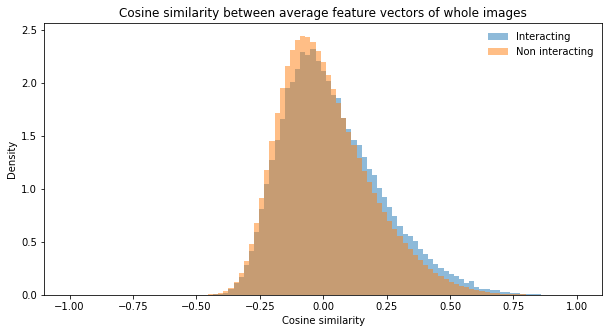

In [1020]:
bins = np.linspace(-1, 1.0, 100)
fig, ax = plt.subplots(1,1,figsize=(10,5), facecolor='white')
plt.hist(distance_matrix[interacting_pairs[:,0], interacting_pairs[:,1]], density=True, bins=bins, alpha=0.5, label='Interacting')
plt.hist(distance_matrix[non_interacting_pairs[:,0], non_interacting_pairs[:,1]], density=True, bins=bins, alpha=0.5, label='Non interacting')
plt.legend(frameon=False)
plt.xlabel('Cosine similarity')
plt.ylabel('Density')
plt.title('Cosine similarity between average feature vectors of whole images')


In [8]:
config_files = [
    'configs/config_hpa_single_cell_from_whole_4_channels_5_epochs.yaml',
    'configs/config_hpa_single_cell_from_whole_combined_5_epochs.yaml',
    'configs/config_hpa_single_cell_from_whole_4_channels_10_epochs.yaml',
    'configs/config_hpa_single_cell_from_whole_combined_10_epochs.yaml',
    'configs/config_hpa_single_cell_from_whole_4_channels_20_epochs.yaml',
    'configs/config_hpa_single_cell_from_whole_4_channels_40_epochs.yaml',
    'configs/config_FAIR_varied_masked_with_norm_0.998_5e-4.yaml',
    'configs/config_FAIR_varied_masked_with_norm_0.996_5e-5.yaml',
    'configs/config_FAIR_varied_masked_with_norm_0.996_5e-4.yaml',
    'configs/config_FAIR_varied_masked_with_norm_0.996_1e-4.yaml',
    'configs/config_FAIR_varied_masked_with_norm_0.996_1e-3.yaml',
    'configs/config_FAIR_varied_masked_with_norm_0.992_5e-4.yaml',
    'configs/config_varied_masked_no_norm_vit_base_HPA_centermom_0.960.yaml',
    'configs/config_varied_masked_no_norm_vit_base_HPA_centermom_0.940.yaml',
    'configs/config_varied_masked_no_norm_vit_base_HPA_centermom_0.920.yaml',
    'configs/config_varied_masked_no_norm_vit_base_HPA_centermom_0.880.yaml',
    'configs/config_varied_masked_no_norm_vit_base_HPA_centermom_0.860.yaml',
    'configs/config_U-2_OS_0.998.yaml',
    'configs/config_U-2_OS_0.998_combined.yaml',
    'configs/config_hpa_single_cell_4_channels.yaml',
    'configs/config_hpa_single_cell_combined.yaml',
]

In [9]:
embeddings = []
config_titles = []
for config_file in tqdm(config_files):
    config = yaml.safe_load(open(config_file, "r"))
    df = pd.read_csv(config['embedding']['df_path'])
    features, protein_localizations, cell_lines, IDs = torch.load(config['embedding']['output_path'])    
    embeddings.append(get_embeddings(features))
    config_titles.append(config["classification"]["output_prefix"])

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 21/21 [2:54:02<00:00, 497.28s/it]


/tmp/ipykernel_4031121/127552189.py:11: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=(10,10), facecolor='white')


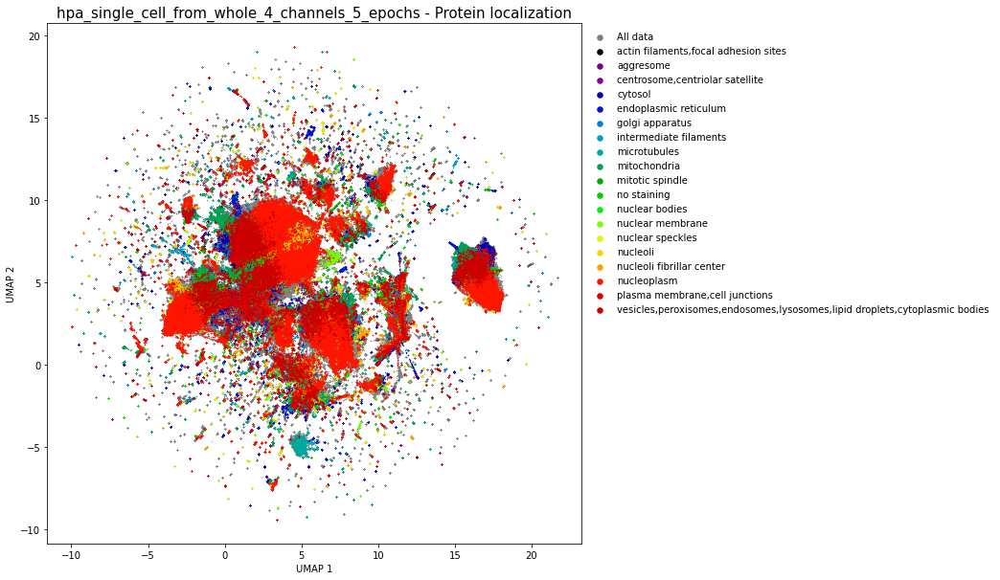

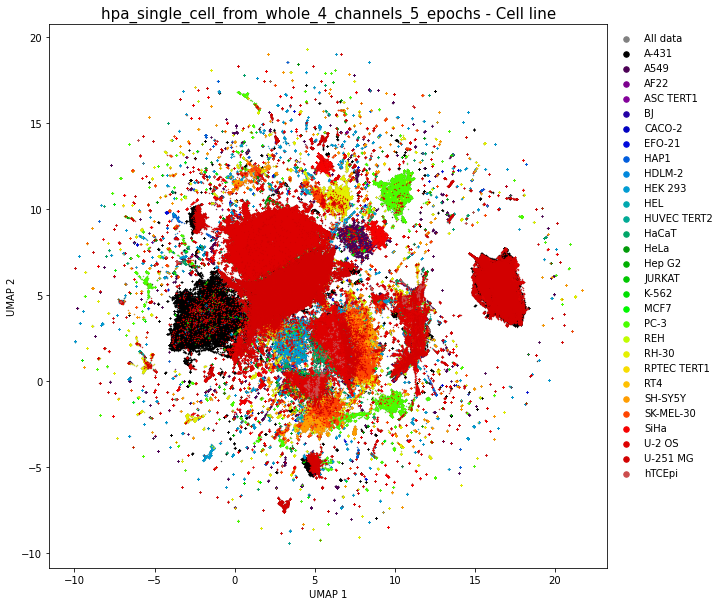

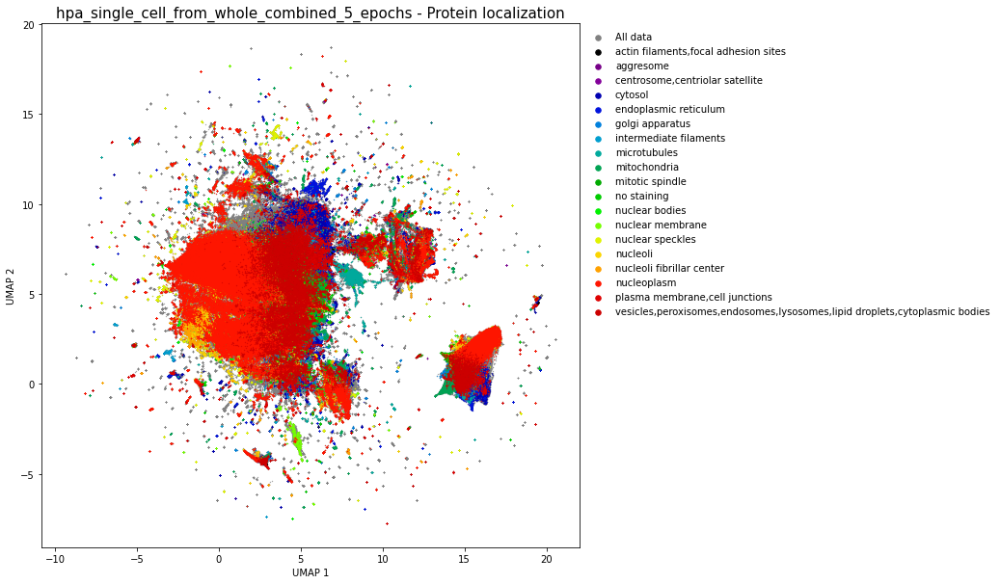

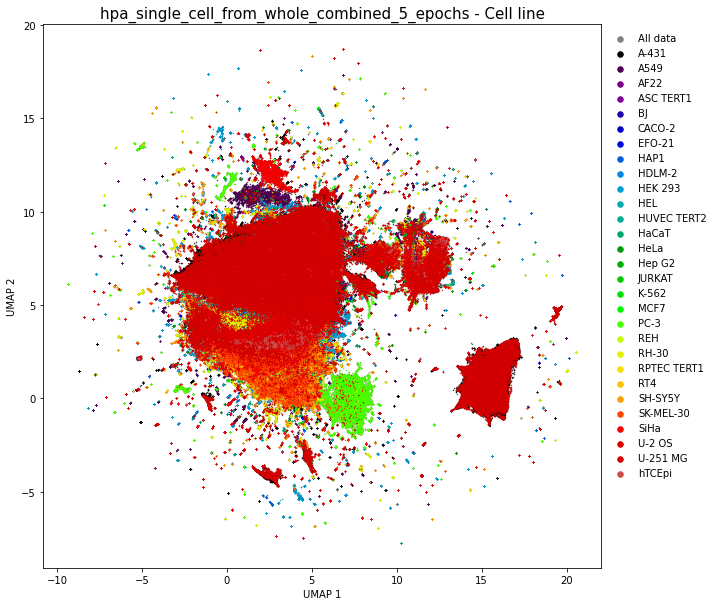

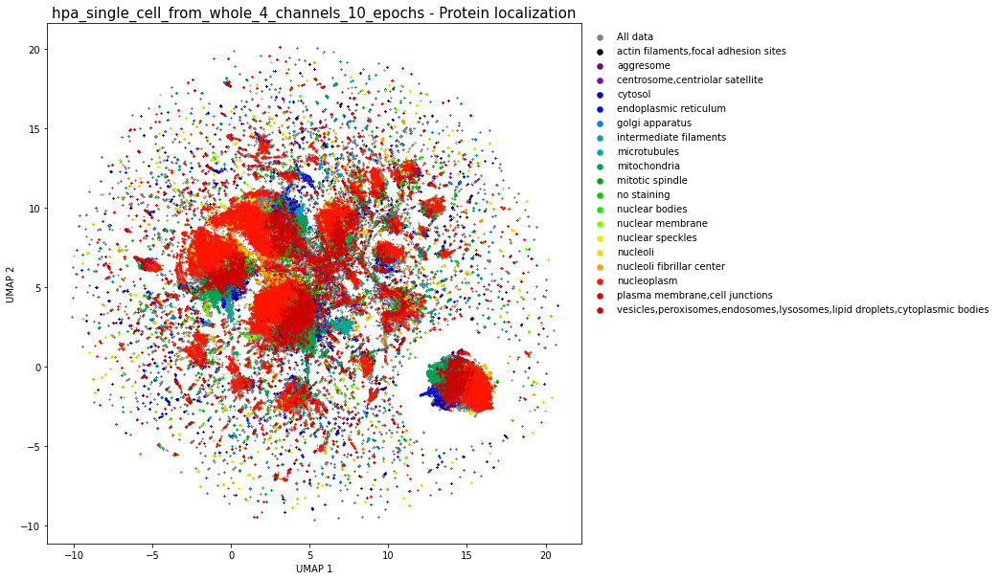

...

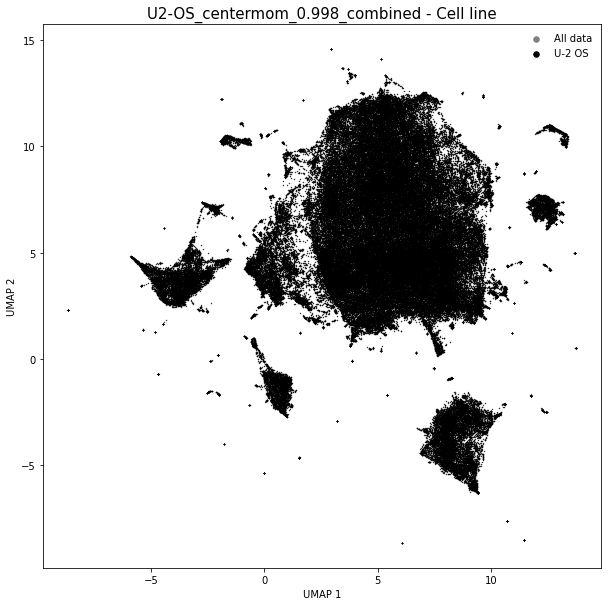

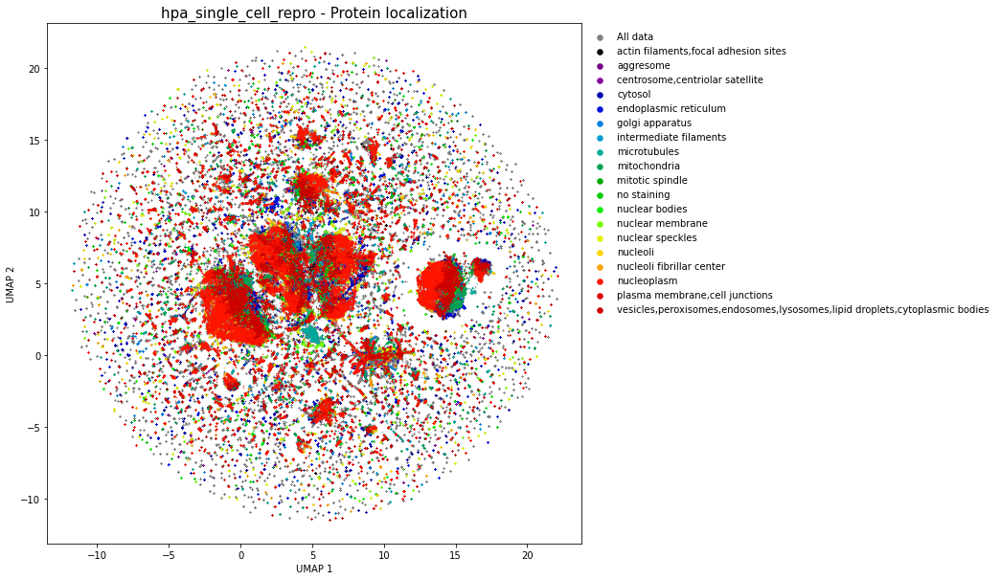

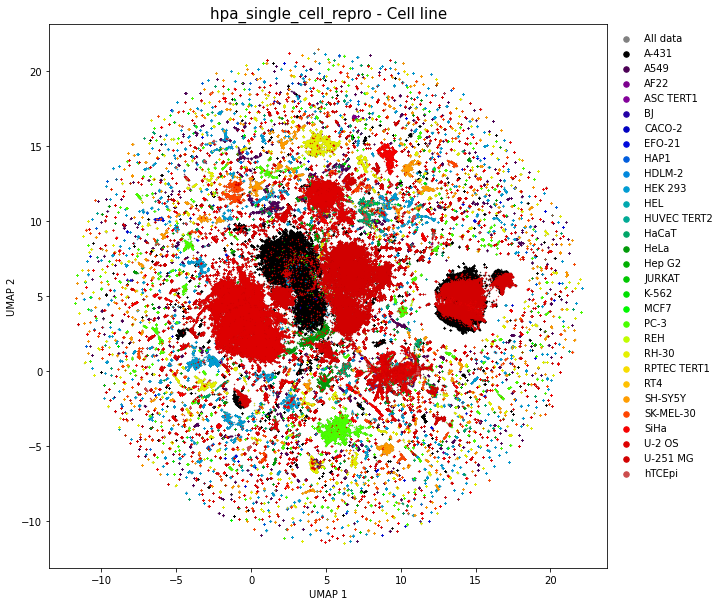

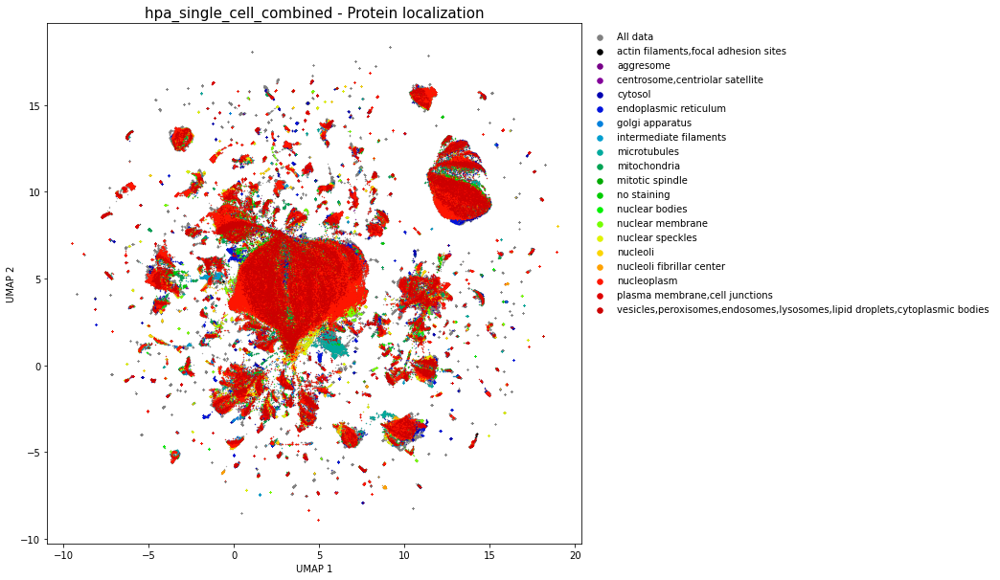

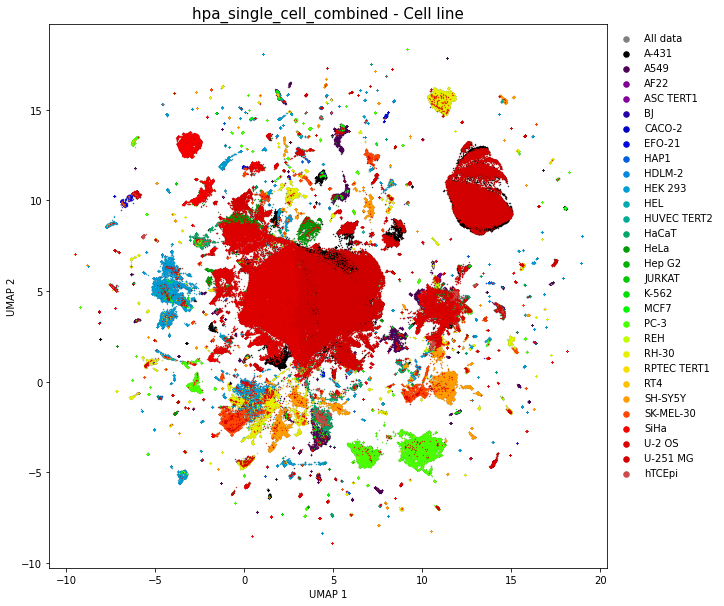

In [15]:
for embedding, title, config_file in zip(embeddings, config_titles, config_files):
    config = yaml.safe_load(open(config_file, "r"))
    df = pd.read_csv(config['embedding']['df_path'])
    plot_UMAP(df, protein_to_num_single_cells, embedding, f'{title} - Protein localization')
    try:
        plot_UMAP(df, ['cell_type'], embedding, f'{title} - Cell line')
    except:
        pass
    


In [ ]:
config_file = 'configs/config_varied_masked_no_norm_vit_base_HPA_centermom_0.998.yaml'
config = yaml.safe_load(open(config_file, "r"))
df = pd.read_csv(config['embedding']['df_path'])
features, protein_localizations, cell_lines, IDs = torch.load(config['embedding']['output_path'])    
embeddings.append(get_embeddings(features))
config_titles.append(config["classification"]["output_prefix"])
embedding = embeddings[-1]
title = config_titles[-1]

config = yaml.safe_load(open(config_file, "r"))
df = pd.read_csv(config['embedding']['df_path'])


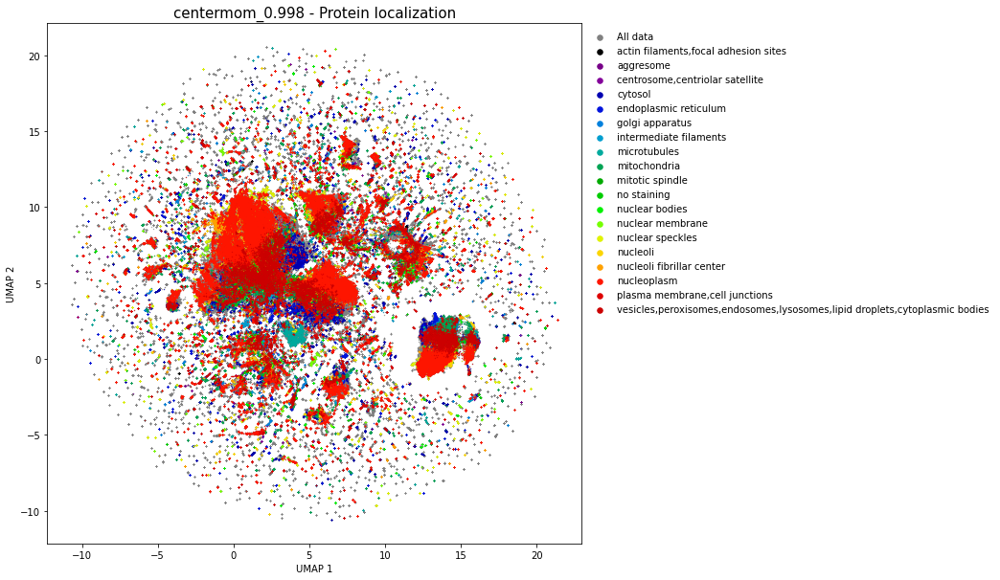

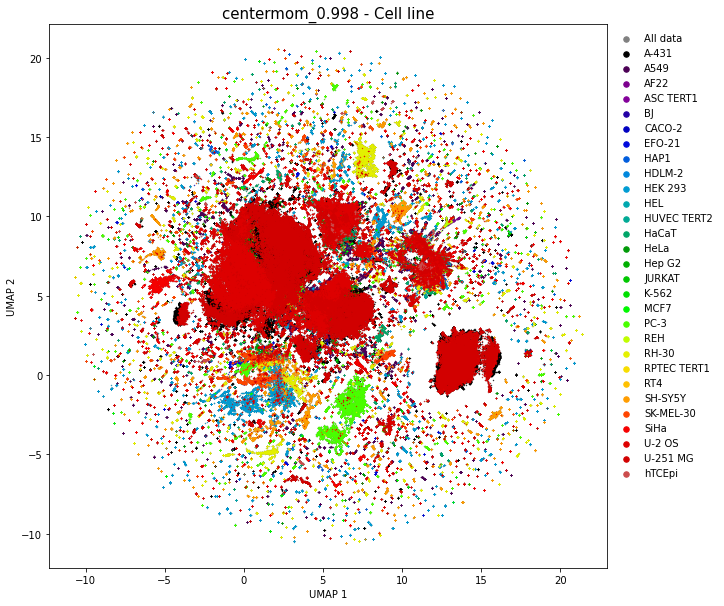

In [17]:
plot_UMAP(df, protein_to_num_single_cells, embedding, f'{title} - Protein localization')
plot_UMAP(df, ['cell_type'], embedding, f'{title} - Cell line')


ValueError: On entry to DHSEQR parameter number 4 had an illegal value

<Figure size 720x720 with 1 Axes>

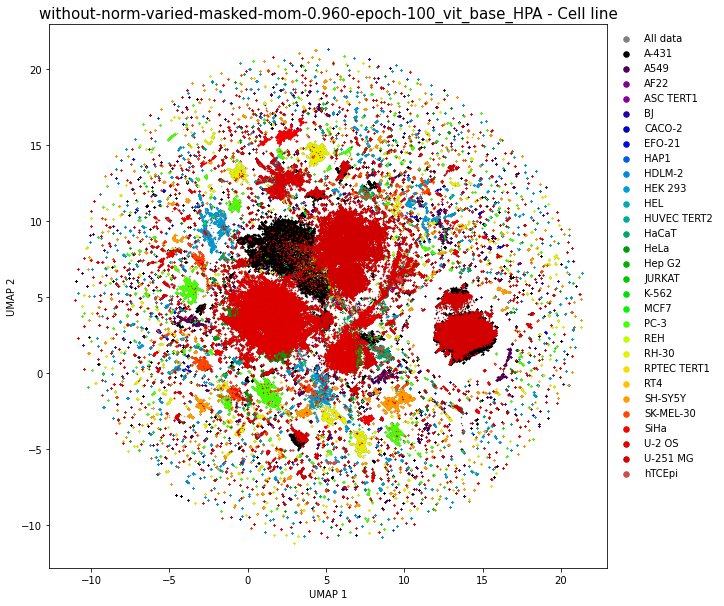

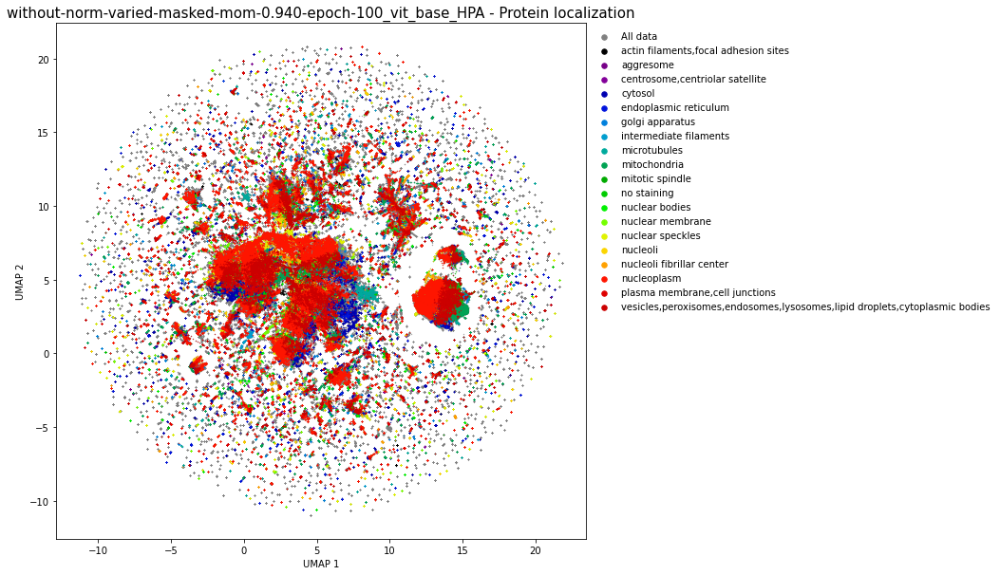

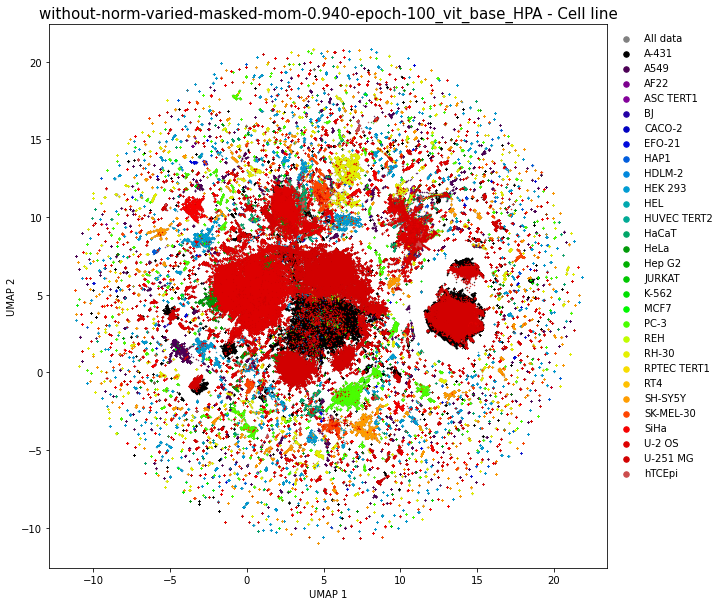

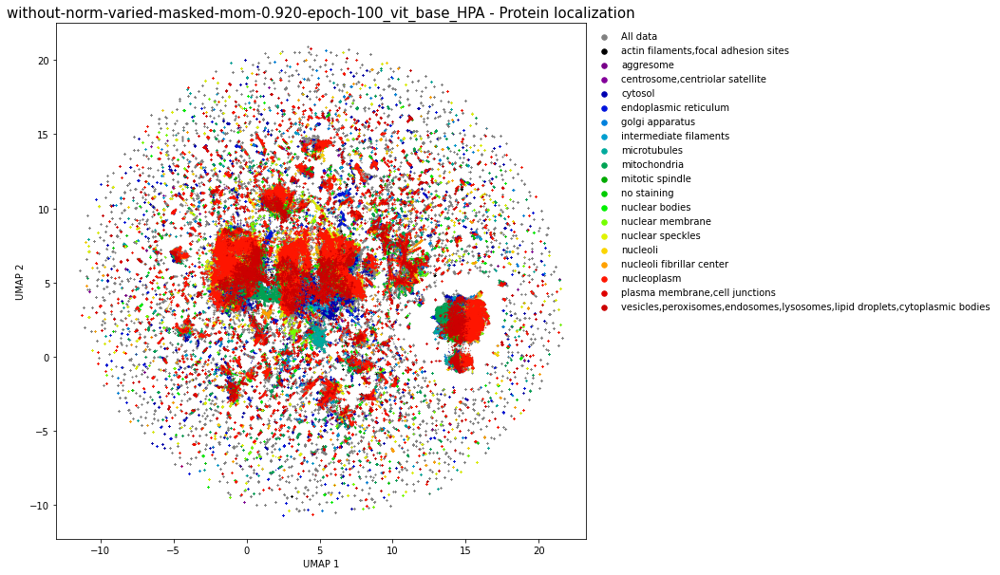

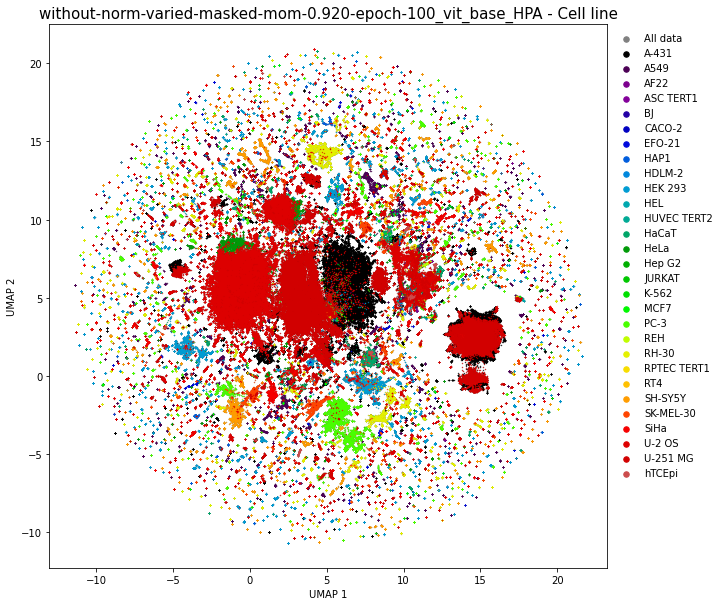

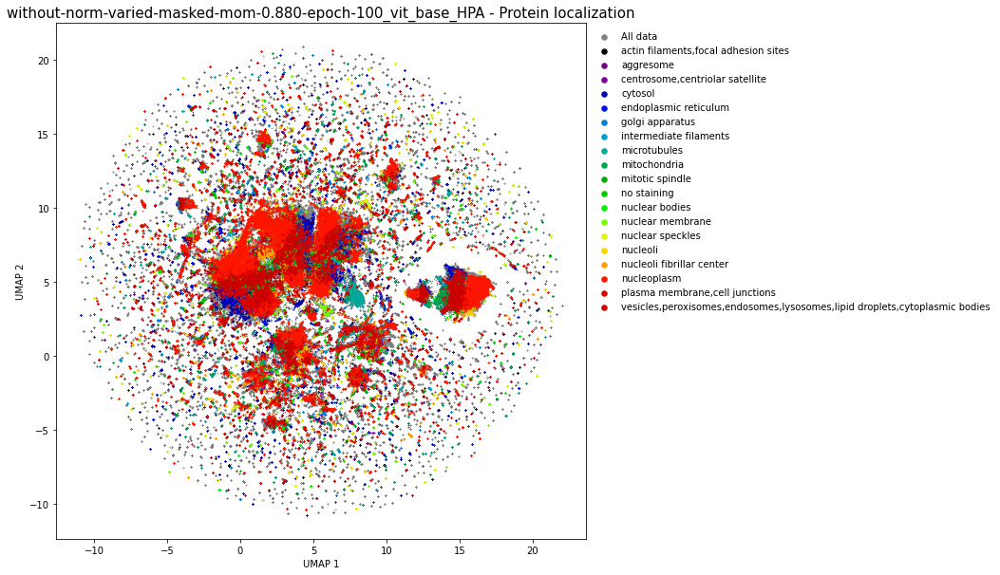

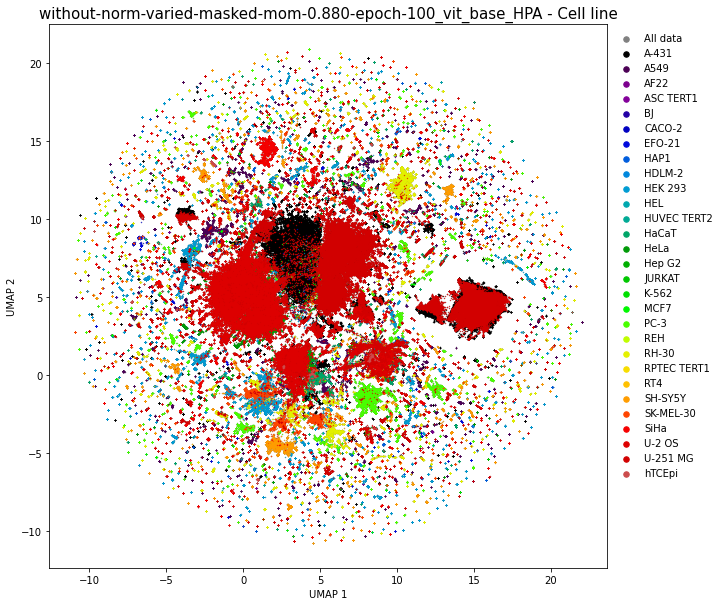

In [19]:
for config_file in ['configs/config_varied_masked_no_norm_vit_base_HPA_centermom_0.960.yaml',
                    'configs/config_varied_masked_no_norm_vit_base_HPA_centermom_0.940.yaml',
                    'configs/config_varied_masked_no_norm_vit_base_HPA_centermom_0.920.yaml',
                    'configs/config_varied_masked_no_norm_vit_base_HPA_centermom_0.880.yaml']:
    config = yaml.safe_load(open(config_file, "r"))
    df = pd.read_csv(config['embedding']['df_path'])
    features, protein_localizations, cell_lines, IDs = torch.load(config['embedding']['output_path'])    
    embeddings.append(get_embeddings(features))
    config_titles.append(config["classification"]["output_prefix"])
    embedding = embeddings[-1]
    title = config_titles[-1]
    plot_UMAP(df, protein_to_num_single_cells, embedding, f'{title} - Protein localization')
    plot_UMAP(df, ['cell_type'], embedding, f'{title} - Cell line')


In [20]:
config_file = 'configs/config_FAIR_varied_masked_with_norm_0.996_5e-4.yaml'
config = yaml.safe_load(open(config_file, "r"))
name = config_file[15:-5]
title = f'/scr/mdoron/Dino4Cells/results/{name}_whole_image/test_features.pth'
features, IDs, impaths = torch.load(title)
mean_features = pd.concat((pd.DataFrame(features.numpy(), columns=[f'feature_{i}' for i in range(features.shape[1])]), pd.DataFrame(IDs, columns=['ID'])), axis=1).groupby('ID').mean().values
mean_impaths = pd.concat((pd.DataFrame((impaths), columns=['0']), pd.DataFrame(IDs, columns=['ID'])), axis=1).groupby('ID').first().values[:,0]
mean_IDs = pd.concat((pd.DataFrame((impaths), columns=['0']), pd.DataFrame(IDs, columns=['ID'])), axis=1).groupby('ID').first().index.values
torch.save((mean_features, mean_IDs, mean_impaths), config['classification']['averaged_test_path'])


In [21]:
for config_file in ['configs/config_FAIR_varied_masked_with_norm_0.996_5e-4.yaml']:    
    config = yaml.safe_load(open(config_file, "r"))
    df = pd.read_csv(config['embedding']['df_path'])
    unique_cell_lines = sorted(df.cell_type.unique())
    cell_line_matrix = np.zeros((len(df), (len(unique_cell_lines))))
    cell_line_groups = df.groupby('cell_type').groups
    unique_cell_lines = sorted(cell_line_groups.keys())
    for ind, unique_cell_line in enumerate(unique_cell_lines):
        cell_line_matrix[cell_line_groups[unique_cell_line], ind] = 1    
    other_df = pd.read_csv('/scr/mdoron/Dino4Cells/data/fixed_size_masked_single_cells_for_whole_image.csv')
    mean_whole_image_protein_localizations = other_df[other_df.ID.isin(df.ID)][['ID'] + sorted(list(protein_to_num_full.keys()))].groupby('ID').first().values.astype(int)
    if len(df) == len(cell_line_matrix):
        features, protein_localizations, cell_lines, IDs = torch.load(config['embedding']['output_path'])    
        protein_localizations = torch.stack(protein_localizations)
        mean_features = pd.concat((pd.DataFrame(features.numpy(), columns=[f'feature_{i}' for i in range(features.shape[1])]), pd.DataFrame(IDs, columns=['ID'])), axis=1).groupby('ID').mean().values
        mean_protein_localizations = pd.concat((pd.DataFrame((protein_localizations).numpy(), columns=[f'p_{i}' for i in range(len(protein_localizations[0]))]), pd.DataFrame(IDs, columns=['ID'])), axis=1).groupby('ID').first().values
        mean_cell_lines = pd.concat((pd.DataFrame((cell_line_matrix.astype(int)), columns=[f'p_{i}' for i in range(len(cell_line_matrix.astype(int)[0]))]), pd.DataFrame(IDs, columns=['ID'])), axis=1).groupby('ID').first().values
        mean_IDs = pd.concat((pd.DataFrame((cell_line_matrix.astype(int)), columns=[f'p_{i}' for i in range(len(cell_line_matrix.astype(int)[0]))]), pd.DataFrame(IDs, columns=['ID'])), axis=1).groupby('ID').first().index.values
        torch.save((mean_features, mean_whole_image_protein_localizations, mean_cell_lines, mean_IDs), config['classification']['averaged_features_path'])


In [29]:
features_df = pd.DataFrame(features.numpy(), columns=[f'feature_{i}' for i in range(features.shape[1])])

In [33]:
features_df.to_csv('features.csv', index=False)


KeyboardInterrupt



In [13]:
import scanpy as sc

In [5]:
# sorted_df = pd.read_csv('/scr/mdoron/allen/cytodata-hackathon-base/results/sorted_df.csv')
sorted_df = pd.read_csv('/scr/mdoron/allen/cytodata-hackathon-base/normalized_cell_df.csv')
# sorted_trained_features = torch.load('/scr/mdoron/allen/cytodata-hackathon-base/results/features.pth')[0]
# sorted_trained_features = torch.load('/scr/mdoron/allen/cytodata-hackathon-base/results_3_channels_centering/normalized_features.pth')[0]
sorted_trained_features = torch.load('/scr/mdoron/allen/cytodata-hackathon-base/results_3_channels/normalized_features.pth')[0]
sorted_trained_features[np.where(np.isnan(sorted_trained_features))] = 0

In [6]:
sorted_trained_features[np.where(np.isnan(sorted_trained_features))] = 0

In [7]:
cleaned_indices = np.where((sorted_df.fits_x == True) &  (sorted_df.fits_y == True))[0]

In [294]:
balanced_indices = np.concatenate([np.random.choice(v, 981,replace=False) for v in sorted_df.groupby('cell_stage').groups.values()])


In [34]:
cell_stage_groups = sorted_df.iloc[cleaned_indices].groupby('cell_stage').groups
balanced_indices = np.concatenate([(cell_stage_groups[key][:981]) for key in cell_stage_groups])
mitochondria_indices = np.where(sorted_df.iloc[cleaned_indices].Structure == 'mitochondria')[0]


In [60]:
sorted_df.iloc[balanced_mitochondria_indices].groupby('cell_stage').count()

,3d_image,angle,bbox_max_x,bbox_max_y,bbox_max_z,bbox_min_x,bbox_min_y,bbox_min_z,bf_clip_hi,bf_clip_lo,...,structure_volume,this_cell_index,this_cell_nbr_complete,this_cell_nbr_dist_2d,WellId,WorkflowId,meta_colony_centroid_1,meta_colony_centroid_2,ID,file
cell_stage,,,,,,,,,,,,,,,,,,,,,
M0,121,121,121,121,121,121,121,121,121,121,...,121,121,121,121,121,121,121,121,121,121
M1M2,121,121,121,121,121,121,121,121,121,121,...,121,121,121,121,121,121,121,121,121,121
M3,121,121,121,121,121,121,121,121,121,121,...,121,121,121,121,121,121,121,121,121,121
M4M5,121,121,121,121,121,121,121,121,121,121,...,121,121,121,121,121,121,121,121,121,121
M6M7_complete,121,121,121,121,121,121,121,121,121,121,...,121,121,121,121,121,121,121,121,121,121
M6M7_single,121,121,121,121,121,121,121,121,121,121,...,121,121,121,121,121,121,121,121,121,121


In [58]:
balanced_mitochondria_indices = np.concatenate([np.random.choice(v, 121, replace=False) for v in sorted_df.iloc[mitochondria_indices].groupby('cell_stage').groups.values()])
balanced_mitochondria_adata = sc.AnnData(sorted_trained_features.numpy()[balanced_mitochondria_indices], 
                   obs=sorted_df.iloc[balanced_mitochondria_indices][['CellId','Structure','cell_stage']], 
                   var=[f'feature_{i}' for i in range(sorted_trained_features.shape[1])])
balanced_mitochondria_adata.uns['iroot'] = np.flatnonzero(balanced_mitochondria_adata.obs['cell_stage'] == 'M1M2')[0]
balanced_mitochondria_neighbors = sc.pp.neighbors(balanced_mitochondria_adata, use_rep='X')
sc.tl.diffmap(balanced_mitochondria_adata, n_comps=10)
balanced_mitochondria_neighbors = sc.pp.neighbors(balanced_mitochondria_adata, use_rep='X', copy=True)
sc.tl.dpt(balanced_mitochondria_adata)
balanced_mitochondria_pseudo_time = balanced_mitochondria_adata.obs['dpt_pseudotime'].values

balanced_mitochondria_transition_matrix = balanced_mitochondria_neighbors.obsp['connectivities']
balanced_mitochondria_eig_val, balanced_mitochondria_eig_vec = eigs(balanced_mitochondria_transition_matrix, k=10)


/scr/mdoron/miniconda3/lib/python3.9/site-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


/scr/mdoron/miniconda3/lib/python3.9/site-packages/matplotlib/collections.py:193: ComplexWarning: Casting complex values to real discards the imaginary part
  offsets = np.asanyarray(offsets, float)


Text(0, 0.5, 'DC 2')

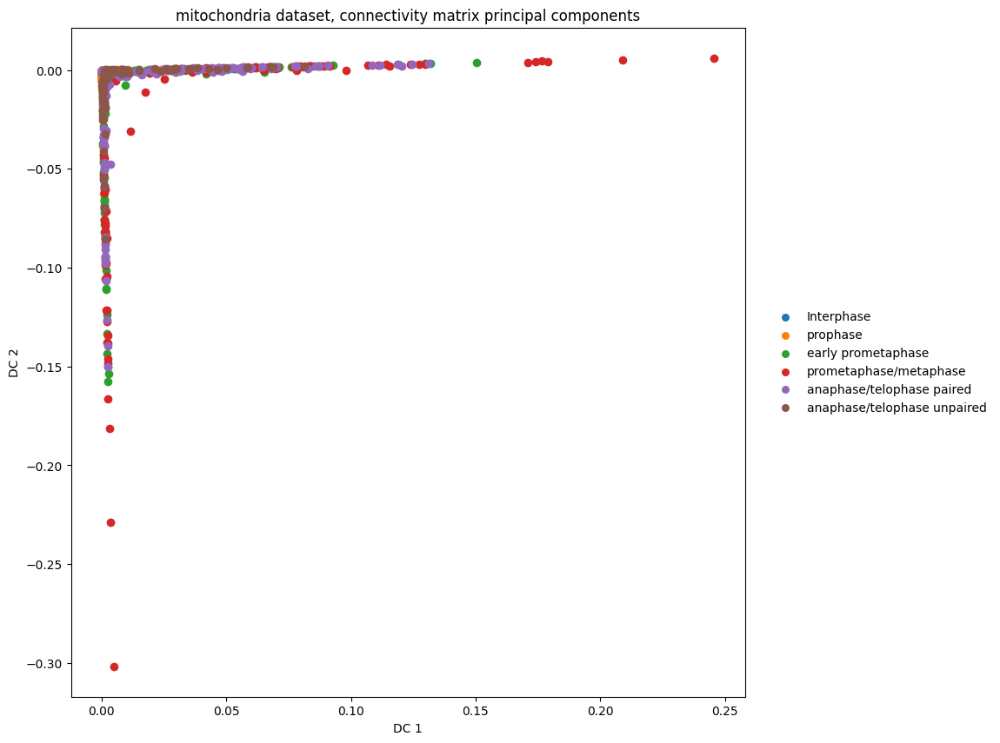

In [59]:
plt.figure(figsize=(10,10), facecolor='white')
for ind, cell_stage in enumerate(unique_values):
    indices = np.where(sorted_df['cell_stage'].iloc[balanced_mitochondria_indices] == cell_stage)[0]
    plt.scatter(balanced_mitochondria_eig_vec[indices, 0],
                balanced_mitochondria_eig_vec[indices, 1],
                label=phases[ind])
lgnd = plt.legend(frameon=False, loc='center', bbox_to_anchor=[1.2, 0.5])
for h in lgnd.legendHandles:
    h._sizes = [30]
plt.title('mitochondria dataset, connectivity matrix principal components')
# plt.axis('off')
plt.xlabel('DC 1')
plt.ylabel('DC 2')


In [35]:
balanced_adata = sc.AnnData(sorted_trained_features.numpy()[balanced_indices], 
                   obs=sorted_df.iloc[balanced_indices][['CellId','Structure','cell_stage']], 
                   var=[f'feature_{i}' for i in range(sorted_trained_features.shape[1])])
mitochondria_adata = sc.AnnData(sorted_trained_features.numpy()[mitochondria_indices], 
                   obs=sorted_df.iloc[mitochondria_indices][['CellId','Structure','cell_stage']], 
                   var=[f'feature_{i}' for i in range(sorted_trained_features.shape[1])])
adata = sc.AnnData(sorted_trained_features.numpy(), 
                   obs=sorted_df[['CellId','Structure','cell_stage']], 
                   var=[f'feature_{i}' for i in range(sorted_trained_features.shape[1])])


/scr/mdoron/miniconda3/lib/python3.9/site-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/scr/mdoron/miniconda3/lib/python3.9/site-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/scr/mdoron/miniconda3/lib/python3.9/site-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/scr/mdoron/miniconda3/lib/python3.9/site-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


In [36]:
balanced_adata.uns['iroot'] = np.flatnonzero(balanced_adata.obs['cell_stage'] == 'M0')[0]
mitochondria_adata.uns['iroot'] = np.flatnonzero(mitochondria_adata.obs['cell_stage'] == 'M0')[0]
adata.uns['iroot'] = np.flatnonzero(adata.obs['cell_stage'] == 'M0')[0]


In [342]:
balanced_neighbors = sc.pp.neighbors(balanced_adata, use_rep='X')
sc.tl.diffmap(balanced_adata, n_comps=10)
balanced_neighbors = sc.pp.neighbors(balanced_adata, use_rep='X', copy=True)
sc.tl.dpt(balanced_adata)
balanced_pseudo_time = balanced_adata.obs['dpt_pseudotime'].values

In [16]:
mitochondria_neighbors = sc.pp.neighbors(mitochondria_adata, use_rep='X')
sc.tl.diffmap(mitochondria_adata, n_comps=10)
mitochondria_neighbors = sc.pp.neighbors(mitochondria_adata, use_rep='X', copy=True)
sc.tl.dpt(mitochondria_adata)
mitochondria_pseudo_time = mitochondria_adata.obs['dpt_pseudotime'].values

In [37]:
balanced_mitochondria_neighbors = sc.pp.neighbors(balanced_mitochondria_adata, use_rep='X')
sc.tl.diffmap(balanced_mitochondria_adata, n_comps=10)
balanced_mitochondria_neighbors = sc.pp.neighbors(balanced_mitochondria_adata, use_rep='X', copy=True)
sc.tl.dpt(balanced_mitochondria_adata)
balanced_mitochondria_pseudo_time = balanced_mitochondria_adata.obs['dpt_pseudotime'].values

In [202]:
neighbors = sc.pp.neighbors(adata, use_rep='X')
sc.tl.diffmap(adata, n_comps=10)
neighbors = sc.pp.neighbors(adata, use_rep='X', copy=True)
sc.tl.dpt(adata)
pseudo_time = adata.obs['dpt_pseudotime'].values

In [301]:
balanced_transition_matrix = balanced_neighbors.obsp['connectivities']

In [38]:
mitochondria_transition_matrix = mitochondria_neighbors.obsp['connectivities']

In [39]:
balanced_mitochondria_transition_matrix = balanced_mitochondria_neighbors.obsp['connectivities']

In [216]:
transition_matrix = neighbors.obsp['connectivities']

In [18]:
from scipy.sparse.linalg import eigs

In [217]:
eig_val, eig_vec = eigs(transition_matrix, k=4)

In [305]:
balanced_eig_val, balanced_eig_vec = eigs(balanced_transition_matrix, k=10)

In [19]:
mitochondria_eig_val, mitochondria_eig_vec = eigs(mitochondria_transition_matrix, k=10)

In [40]:
balanced_mitochondria_eig_val, balanced_mitochondria_eig_vec = eigs(balanced_mitochondria_transition_matrix, k=10)

In [308]:
eig_vec = eig_vec.astype(float)


In [20]:
unique_values = sorted(sorted_df['cell_stage'].unique())
continuous_cell_stage_dict = {'M0' : np.linspace(0,1,6)[0],
                   'M1M2' : np.linspace(0,1,6)[1], 
                   'M3' : np.linspace(0,1,6)[2], 
                   'M4M5' : np.linspace(0,1,6)[3], 
                   'M6M7_complete' : np.linspace(0,1,6)[4], 
                   'M6M7_single' : np.linspace(0,1,6)[5]}

discrete_cell_stage_dict = {'M0' : 0,
                   'M1M2' : 1, 
                   'M3' : 2, 
                   'M4M5' : 3, 
                   'M6M7_complete' : 4, 
                   'M6M7_single' : 5}
phases = ['Interphase', 
'prophase', 
'early prometaphase', 
'prometaphase/metaphase', 
'anaphase/telophase paired',
'anaphase/telophase unpaired', 
]

/scr/mdoron/miniconda3/lib/python3.9/site-packages/matplotlib/collections.py:193: ComplexWarning: Casting complex values to real discards the imaginary part
  offsets = np.asanyarray(offsets, float)


Text(0, 0.5, 'DC 2')

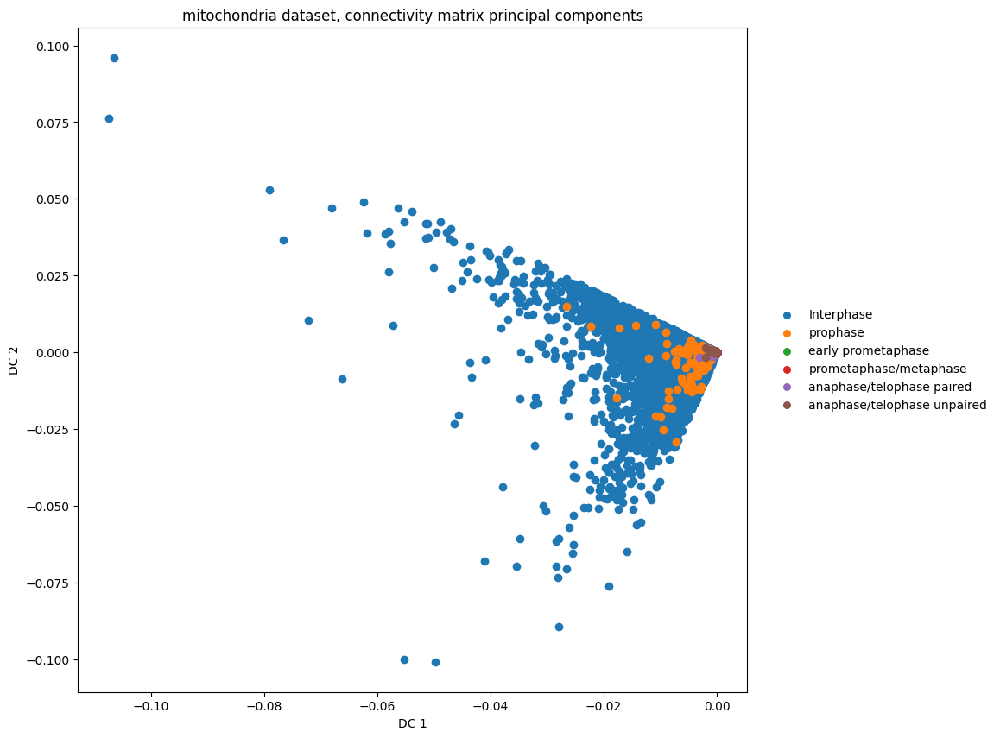

In [21]:
plt.figure(figsize=(10,10), facecolor='white')
for ind, cell_stage in enumerate(unique_values):
    indices = np.where(sorted_df['cell_stage'].iloc[mitochondria_indices] == cell_stage)[0]
    plt.scatter(mitochondria_eig_vec[indices, 0],
                mitochondria_eig_vec[indices, 1],
                label=phases[ind])
lgnd = plt.legend(frameon=False, loc='center', bbox_to_anchor=[1.2, 0.5])
for h in lgnd.legendHandles:
    h._sizes = [30]
plt.title('mitochondria dataset, connectivity matrix principal components')
# plt.axis('off')
plt.xlabel('DC 1')
plt.ylabel('DC 2')


Text(0, 0.5, 'DC 2')

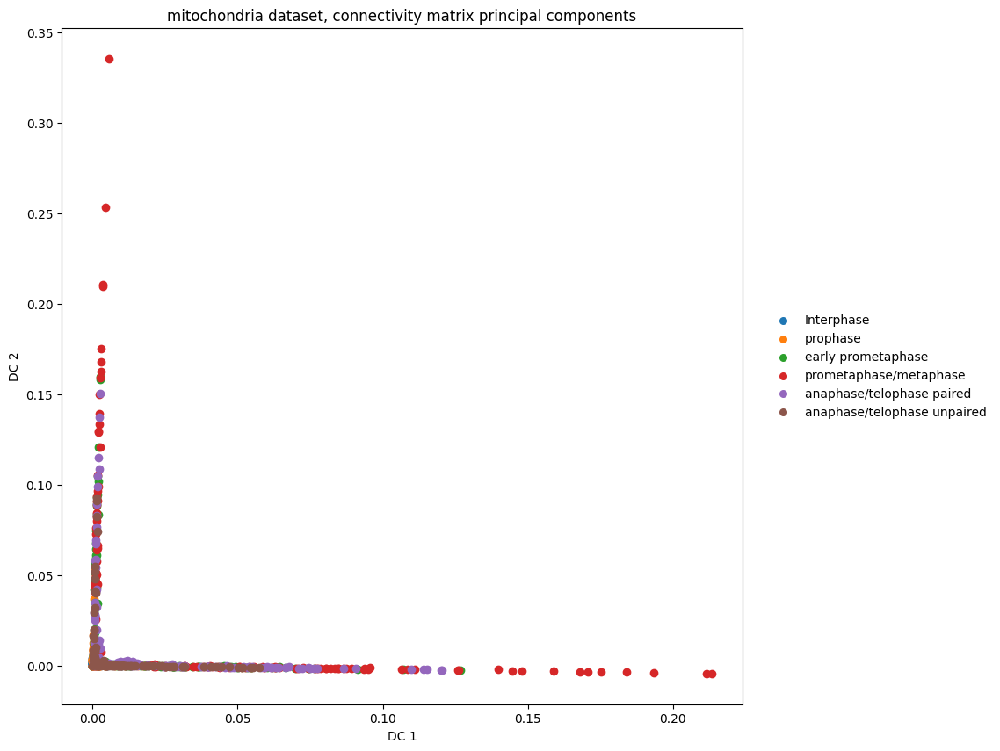

In [42]:
plt.figure(figsize=(10,10), facecolor='white')
for ind, cell_stage in enumerate(unique_values):
    indices = np.where(sorted_df['cell_stage'].iloc[balanced_mitochondria_indices] == cell_stage)[0]
    plt.scatter(balanced_mitochondria_eig_vec[indices, 0],
                balanced_mitochondria_eig_vec[indices, 1],
                label=phases[ind])
lgnd = plt.legend(frameon=False, loc='center', bbox_to_anchor=[1.2, 0.5])
for h in lgnd.legendHandles:
    h._sizes = [30]
plt.title('mitochondria dataset, connectivity matrix principal components')
# plt.axis('off')
plt.xlabel('DC 1')
plt.ylabel('DC 2')


Text(0, 0.5, 'DC 2')

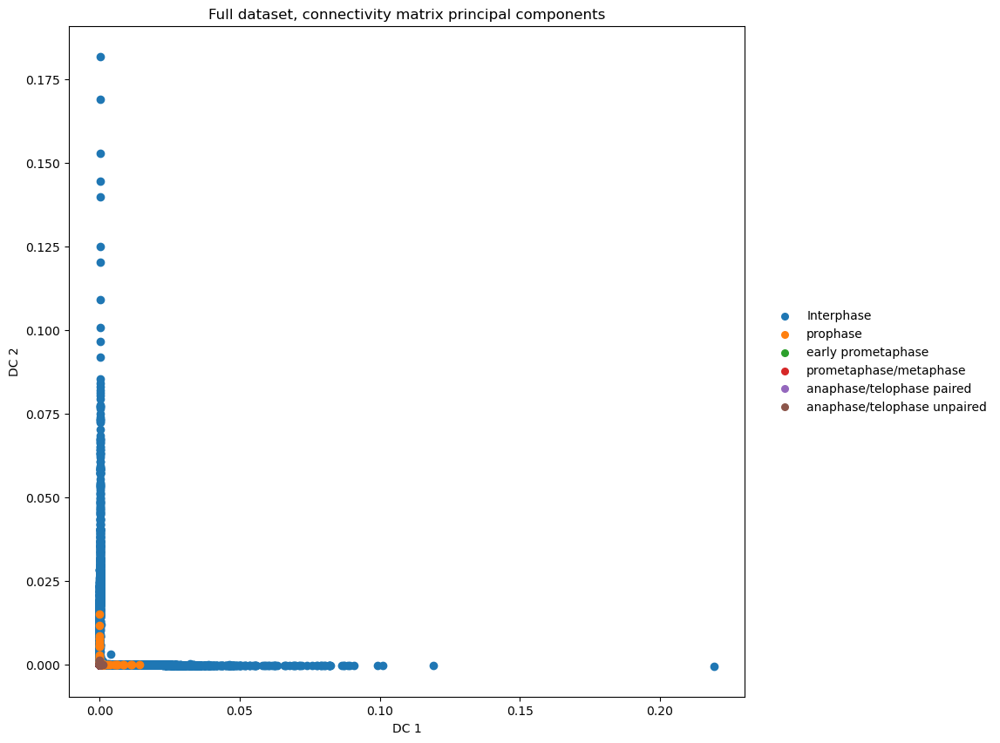

In [220]:
plt.figure(figsize=(10,10), facecolor='white')
for ind, cell_stage in enumerate(unique_values):
    indices = np.where(sorted_df['cell_stage'] == cell_stage)[0]
    plt.scatter(eig_vec[indices, 0], 
                eig_vec[indices, 1],
                label=phases[ind])
lgnd = plt.legend(frameon=False, loc='center', bbox_to_anchor=[1.2, 0.5])
for h in lgnd.legendHandles:
    h._sizes = [30]
plt.title('Full dataset, connectivity matrix principal components')
# plt.axis('off')
plt.xlabel('DC 1')
plt.ylabel('DC 2')


Text(0, 0.5, 'DC 2')

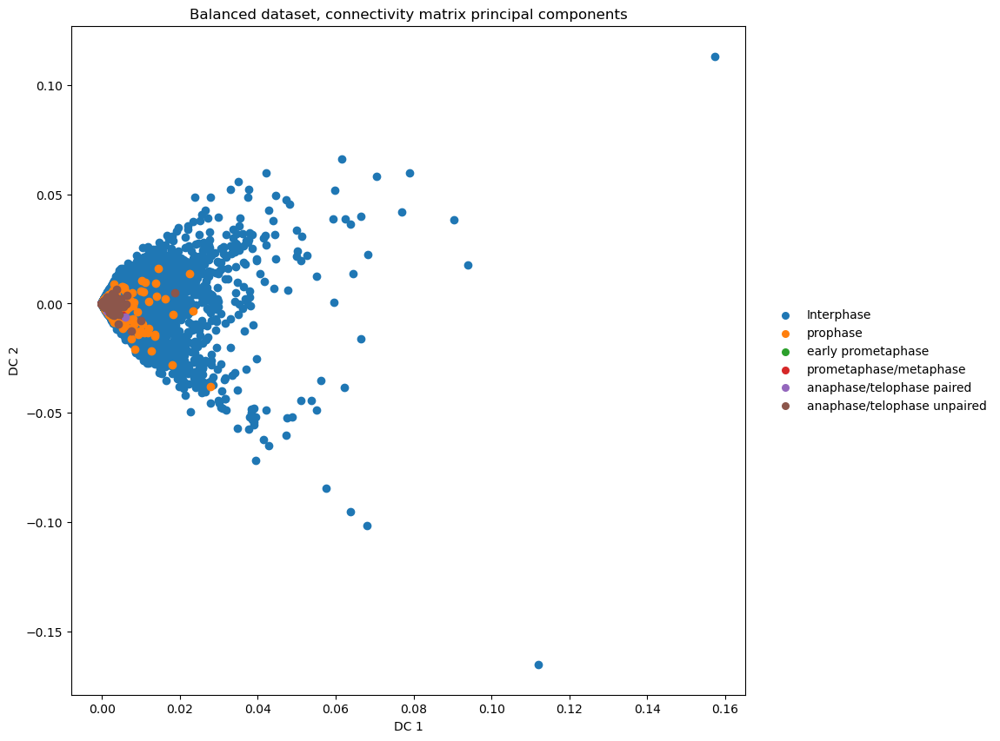

In [359]:
plt.figure(figsize=(10,10), facecolor='white')
for ind, cell_stage in enumerate(unique_values):
    indices = np.where(sorted_df['cell_stage'].iloc[mitochondria_indices] == cell_stage)[0]
    plt.scatter(mitochondria_eig_vec[indices, 0],
                mitochondria_eig_vec[indices, 1],
                label=phases[ind])
lgnd = plt.legend(frameon=False, loc='center', bbox_to_anchor=[1.2, 0.5])
for h in lgnd.legendHandles:
    h._sizes = [30]
plt.title('Balanced dataset, connectivity matrix principal components')
# plt.axis('off')
plt.xlabel('DC 1')
plt.ylabel('DC 2')


Text(0, 0.5, 'DC 2')

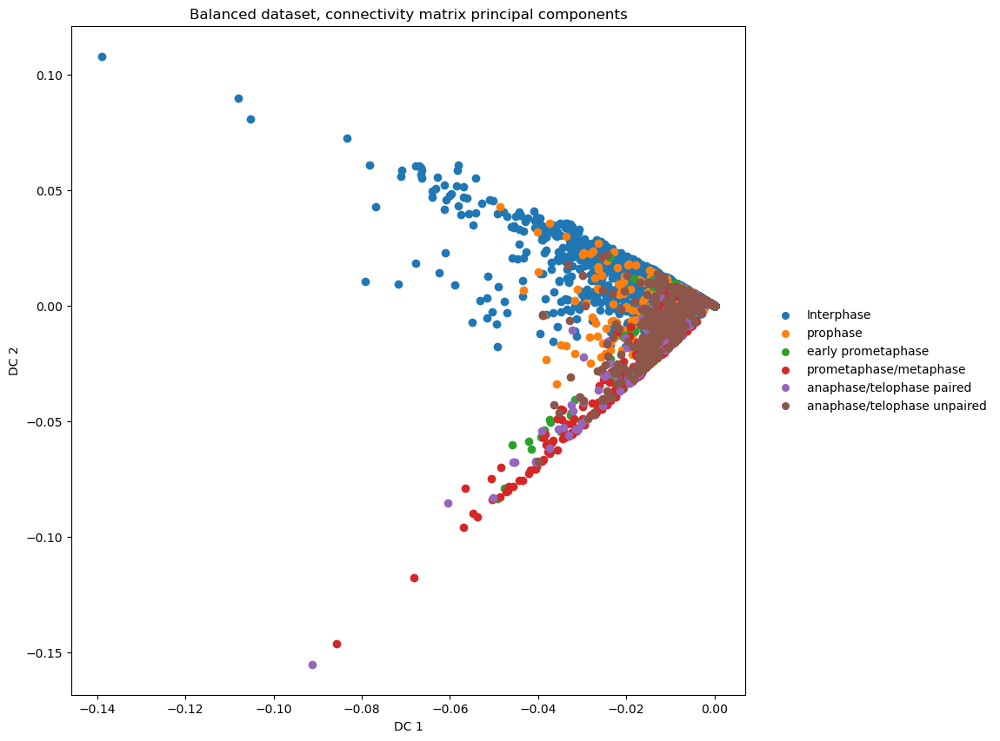

In [355]:
plt.figure(figsize=(10,10), facecolor='white')
for ind, cell_stage in enumerate(unique_values):
    indices = np.where(sorted_df['cell_stage'].iloc[balanced_indices] == cell_stage)[0]
    plt.scatter(balanced_eig_vec[indices, 0],
                balanced_eig_vec[indices, 1],
                label=phases[ind])
lgnd = plt.legend(frameon=False, loc='center', bbox_to_anchor=[1.2, 0.5])
for h in lgnd.legendHandles:
    h._sizes = [30]
plt.title('Balanced dataset, connectivity matrix principal components')
# plt.axis('off')
plt.xlabel('DC 1')
plt.ylabel('DC 2')


Text(0, 0.5, 'DC 2')

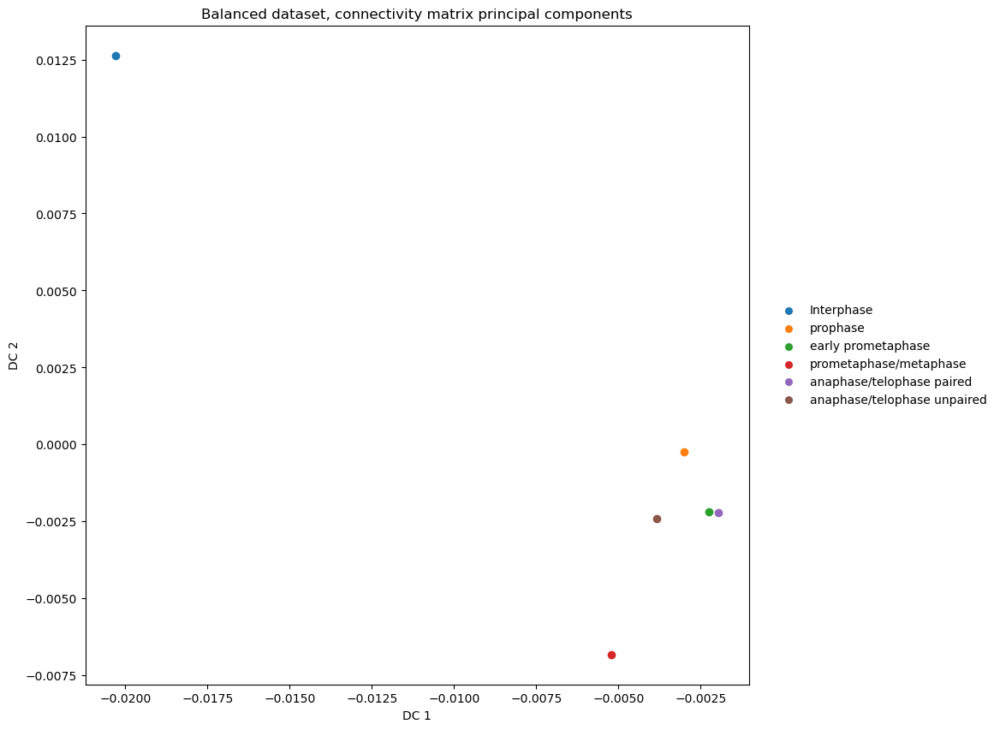

In [336]:
plt.figure(figsize=(10,10), facecolor='white')
for ind, cell_stage in enumerate(unique_values):
    indices = np.where(sorted_df['cell_stage'].iloc[balanced_indices] == cell_stage)[0]
    plt.scatter(balanced_eig_vec[indices, 0].mean(),
                balanced_eig_vec[indices, 1].mean(),
                label=phases[ind])
lgnd = plt.legend(frameon=False, loc='center', bbox_to_anchor=[1.2, 0.5])
for h in lgnd.legendHandles:
    h._sizes = [30]
plt.title('Balanced dataset, connectivity matrix principal components')
# plt.axis('off')
plt.xlabel('DC 1')
plt.ylabel('DC 2')


In [61]:
from scipy.stats import pearsonr
cell_stage_groups = sorted_df.iloc[balanced_indices].reset_index().groupby(['cell_stage']).groups

pseudo_time_divided_by_cell_stages = [balanced_pseudo_time[cell_stage_groups[k]] for k in sorted(cell_stage_groups.keys())]

no_inf_balanced_pseudo_time = np.where(balanced_pseudo_time == np.inf, np.nan, balanced_pseudo_time)

# ttest_ind(pseudo_time_divided_by_cell_stages[1], pseudo_time_divided_by_cell_stages[2])

mean_pseudotime = [np.nanmean(no_inf_balanced_pseudo_time[cell_stage_groups[k]]) for k in sorted(cell_stage_groups.keys())]
std_pseudotime = [np.nanstd(no_inf_balanced_pseudo_time[cell_stage_groups[k]]) for k in sorted(cell_stage_groups.keys())]

fig, ax = plt.subplots(figsize=(5,5))
plt.errorbar(x = range(6), y = mean_pseudotime, yerr=std_pseudotime, capsize=10, color='black')
plt.xticks(range(6), phases, rotation=45)
plt.ylabel('Pseudotime')
plt.title('Mean pseudotime by cell stage')

for x1 in range(5):
    x2 = x1 + 1
    pvalue = (ttest_ind(pseudo_time_divided_by_cell_stages[x1], pseudo_time_divided_by_cell_stages[x2])[1] * 5)
    pvalue = '***' if pvalue < 0.001 else 'ns'
    y, h, col = max(mean_pseudotime) + max(std_pseudotime), 0.05, 'k'
    plt.plot([x1 + 0.1, x1 + 0.1, x2 - 0.1, x2 - 0.1], [y, y+h, y+h, y], lw=1.5, c=col)
    plt.text((x1+x2)*.5, y+h, pvalue, ha='center', va='bottom', color=col)


NameError: name 'balanced_pseudo_time' is not defined

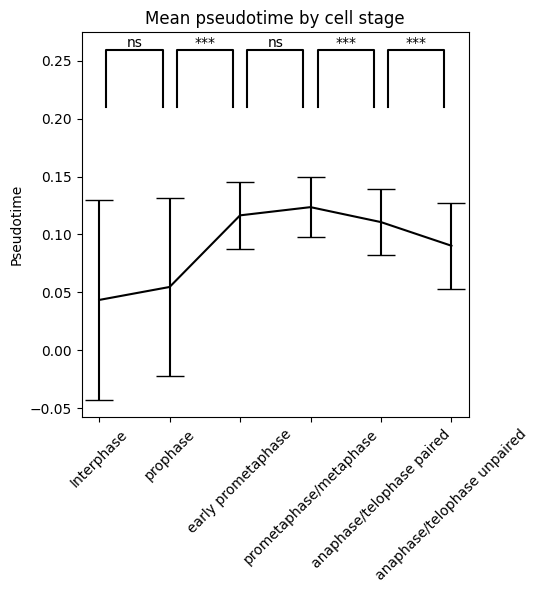

In [62]:
from scipy.stats import pearsonr
cell_stage_groups = sorted_df.iloc[mitochondria_indices].reset_index().groupby(['cell_stage']).groups

pseudo_time_divided_by_cell_stages = [mitochondria_pseudo_time[cell_stage_groups[k]] for k in sorted(cell_stage_groups.keys())]

no_inf_mitochondria_pseudo_time = np.where(mitochondria_pseudo_time == np.inf, np.nan, mitochondria_pseudo_time)

# ttest_ind(pseudo_time_divided_by_cell_stages[1], pseudo_time_divided_by_cell_stages[2])

mean_pseudotime = [np.nanmean(no_inf_mitochondria_pseudo_time[cell_stage_groups[k]]) for k in sorted(cell_stage_groups.keys())]
std_pseudotime = [np.nanstd(no_inf_mitochondria_pseudo_time[cell_stage_groups[k]]) for k in sorted(cell_stage_groups.keys())]

fig, ax = plt.subplots(figsize=(5,5))
plt.errorbar(x = range(6), y = mean_pseudotime, yerr=std_pseudotime, capsize=10, color='black')
plt.xticks(range(6), phases, rotation=45)
plt.ylabel('Pseudotime')
plt.title('Mean pseudotime by cell stage')

for x1 in range(5):
    x2 = x1 + 1
    pvalue = (ttest_ind(pseudo_time_divided_by_cell_stages[x1], pseudo_time_divided_by_cell_stages[x2])[1] * 5)
    pvalue = '***' if pvalue < 0.001 else 'ns'
    y, h, col = max(mean_pseudotime) + max(std_pseudotime), 0.05, 'k'
    plt.plot([x1 + 0.1, x1 + 0.1, x2 - 0.1, x2 - 0.1], [y, y+h, y+h, y], lw=1.5, c=col)
    plt.text((x1+x2)*.5, y+h, pvalue, ha='center', va='bottom', color=col)


In [63]:
from scipy.stats import pearsonr
cell_stage_groups = sorted_df.groupby(['cell_stage']).groups

no_inf_pseudo_time = np.where(pseudo_time == np.inf, 0, pseudo_time)

pseudo_time_divided_by_cell_stages = [pseudo_time[cell_stage_groups[k]] for k in sorted(cell_stage_groups.keys())]
pseudo_time_divided_by_cell_stages = [np.where(np.array(k) == np.inf, 0, k) for k in pseudo_time_divided_by_cell_stages]
# ttest_ind(pseudo_time_divided_by_cell_stages[1], pseudo_time_divided_by_cell_stages[2])

mean_pseudotime = [no_inf_pseudo_time[cell_stage_groups[k]].mean() for k in sorted(cell_stage_groups.keys())]
std_pseudotime = [no_inf_pseudo_time[cell_stage_groups[k]].std() for k in sorted(cell_stage_groups.keys())]

fig, ax = plt.subplots(figsize=(5,5))
plt.errorbar(x = range(6), y = mean_pseudotime, yerr=std_pseudotime, capsize=10, color='black')
plt.xticks(range(6), phases, rotation=45)
plt.ylabel('Pseudotime')
plt.title('Mean pseudotime by cell stage')

for x1 in range(5):
    x2 = x1 + 1
    pvalue = (ttest_ind(pseudo_time_divided_by_cell_stages[x1], pseudo_time_divided_by_cell_stages[x2])[1] * 5)
    pvalue = '***' if pvalue < 0.001 else 'ns'
    y, h, col = max(mean_pseudotime) + max(std_pseudotime), 0.05, 'k'
    plt.plot([x1 + 0.1, x1 + 0.1, x2 - 0.1, x2 - 0.1], [y, y+h, y+h, y], lw=1.5, c=col)
    plt.text((x1+x2)*.5, y+h, pvalue, ha='center', va='bottom', color=col)


NameError: name 'pseudo_time' is not defined

In [356]:
pvalues = [(ttest_ind(pseudo_time_divided_by_cell_stages[i], pseudo_time_divided_by_cell_stages[i + 1])[1] * 5) for i in range(5)]
pvalue_text = ['***' if p < 0.0001 else 'ns' for p in pvalues]

pvalues

[nan, nan, nan, nan, nan]

In [313]:
balanced_embedding = get_embeddings(sorted_trained_features[balanced_indices,:])
embedding = get_embeddings(sorted_trained_features)


No handles with labels found to put in legend.


(-13.560070133209228,
 22.449422931671144,
 -13.551054573059082,
 24.146860694885255)

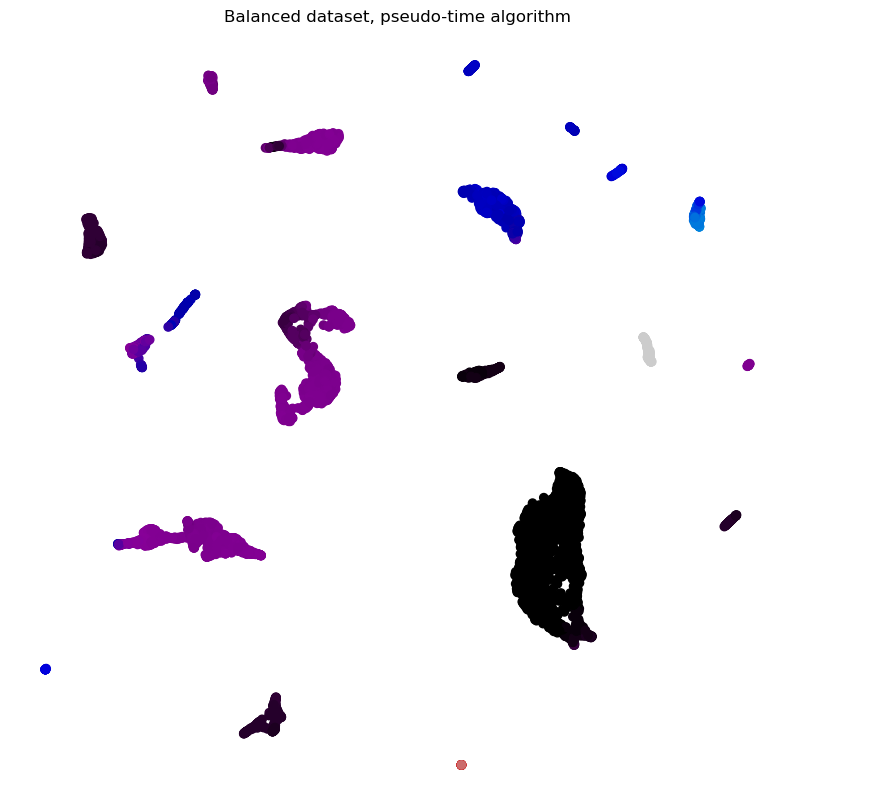

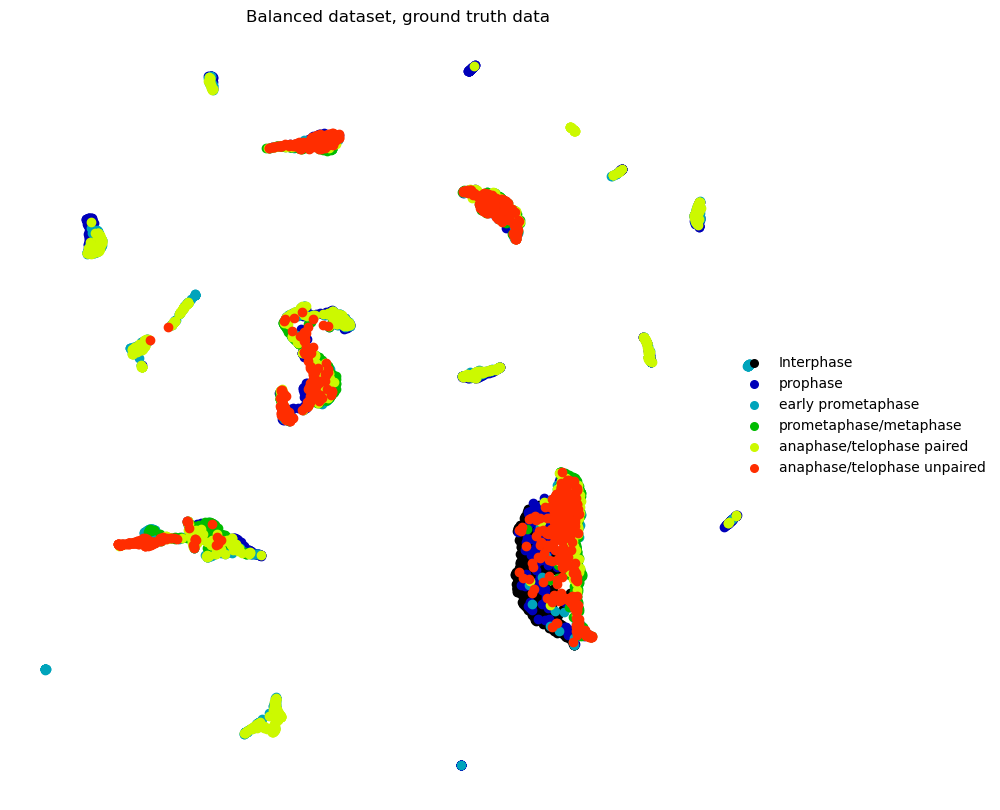

In [357]:
from matplotlib import cm
cmap = cm.nipy_spectral

plt.figure(figsize=(10,10), facecolor='white')
unique_values = sorted(sorted_df['cell_stage'].unique())
for ind, cell_stage in enumerate(unique_values):
    indices = np.where(sorted_df['cell_stage'].iloc[balanced_indices] == cell_stage)[0]
    plt.scatter(balanced_embedding[indices,0],
                balanced_embedding[indices,1],
                color=cmap(balanced_pseudo_time[indices]))

lgnd = plt.legend(frameon=False, loc='center', bbox_to_anchor=[1.1, 0.5])
for h in lgnd.legendHandles:
    h._sizes = [30]
plt.title('Balanced dataset, pseudo-time algorithm')
plt.axis('off')

plt.figure(figsize=(10,10), facecolor='white')
for ind, cell_stage in enumerate(unique_values):
    indices = np.where(sorted_df['cell_stage'].iloc[balanced_indices] == cell_stage)[0]
    plt.scatter(balanced_embedding[indices,0],
                balanced_embedding[indices,1],
                color=cmap(ind / len(unique_values)),
               label=phases[ind])
        
lgnd = plt.legend(frameon=False, loc='center', bbox_to_anchor=[1.1, 0.5])
for h in lgnd.legendHandles:
    h._sizes = [30]
plt.title('Balanced dataset, ground truth data')
plt.axis('off')


Text(0.5, 1.0, 'Full dataset, ground truth data')

<Figure size 1000x1000 with 0 Axes>

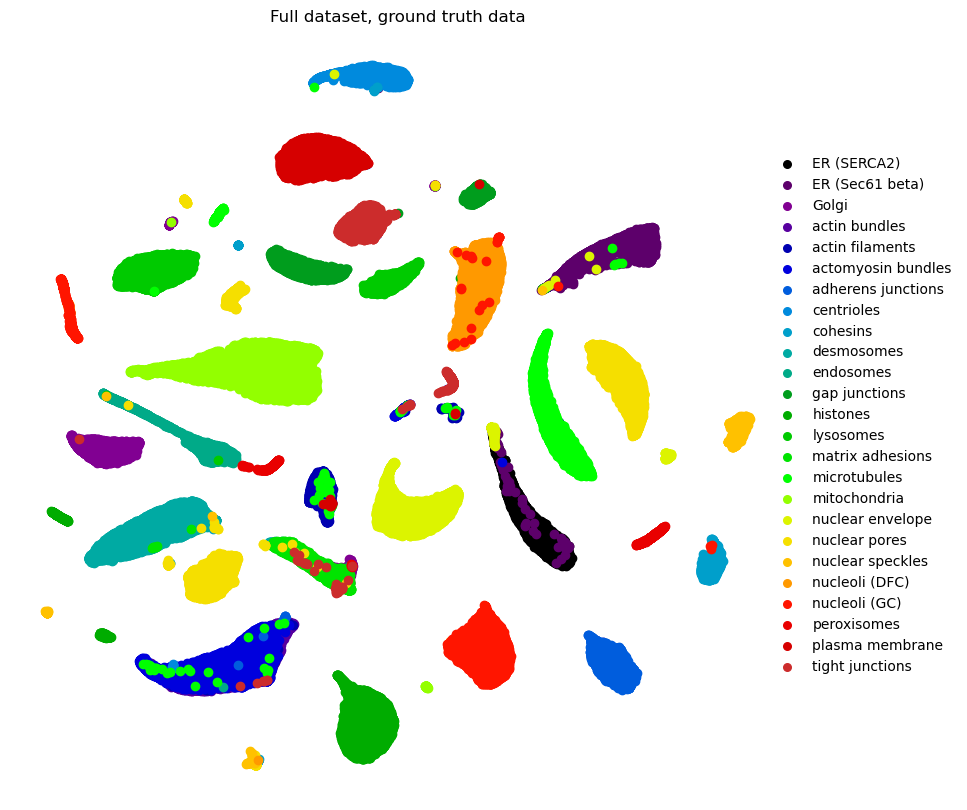

In [316]:
from matplotlib import cm
cmap = cm.nipy_spectral

plt.figure(figsize=(10,10), facecolor='white')
unique_values = sorted(sorted_df['Structure'].unique())
plt.figure(figsize=(10,10), facecolor='white')
for ind, cell_stage in enumerate(unique_values):
    indices = np.where(sorted_df['Structure'] == cell_stage)[0]
    plt.scatter(embedding[indices,0],
                embedding[indices,1],
                color=cmap(ind / len(unique_values)),
               label=cell_stage)
        
lgnd = plt.legend(frameon=False, loc='center', bbox_to_anchor=[1.1, 0.5])
for h in lgnd.legendHandles:
    h._sizes = [30]
plt.axis('off')
plt.title('Full dataset, ground truth data')


No handles with labels found to put in legend.


Text(0.5, 1.0, 'Full dataset, ground truth data')

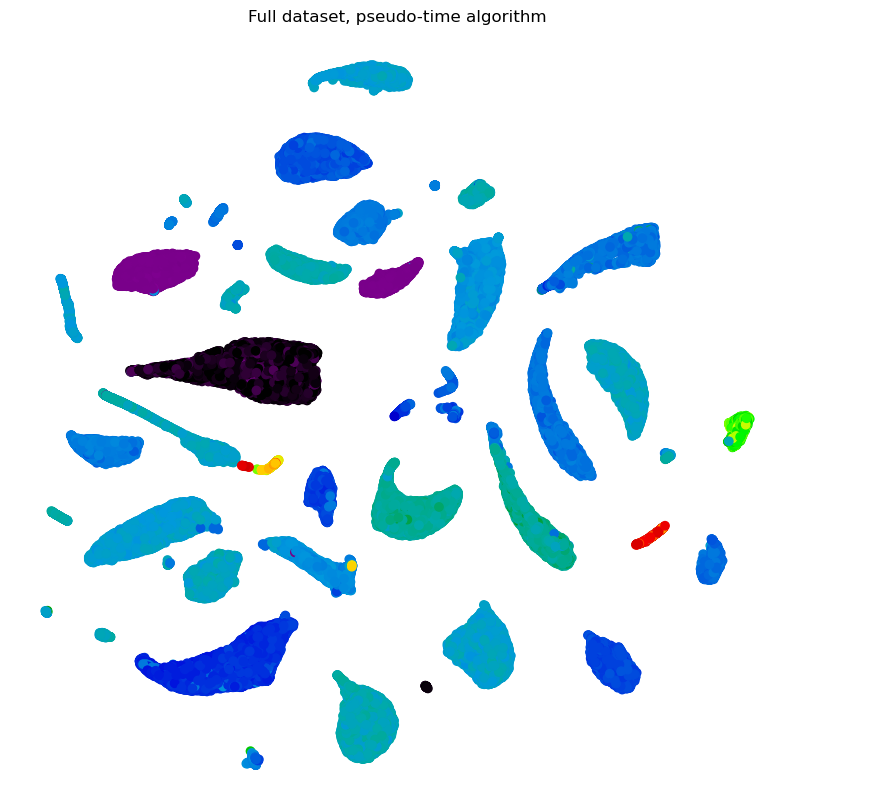

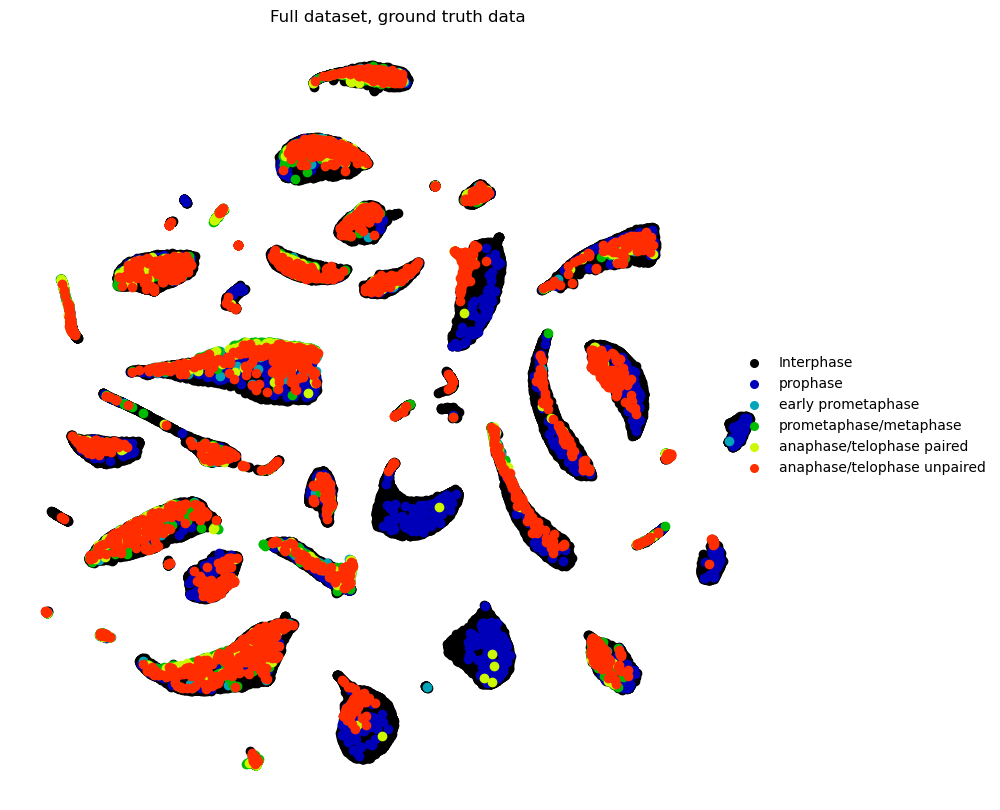

In [340]:
from matplotlib import cm
cmap = cm.nipy_spectral

plt.figure(figsize=(10,10), facecolor='white')
unique_values = sorted(sorted_df['cell_stage'].unique())
for ind, cell_stage in enumerate(unique_values):
    indices = np.where(sorted_df['cell_stage'] == cell_stage)[0]
    plt.scatter(embedding[indices,0],
                embedding[indices,1],
                color=cmap(pseudo_time[indices]))
        
lgnd = plt.legend(frameon=False, loc='center', bbox_to_anchor=[1.1, 0.5])
for h in lgnd.legendHandles:
    h._sizes = [30]
plt.title('Full dataset, pseudo-time algorithm')
plt.axis('off')

plt.figure(figsize=(10,10), facecolor='white')
for ind, cell_stage in enumerate(unique_values):
    indices = np.where(sorted_df['cell_stage'] == cell_stage)[0]
    plt.scatter(embedding[indices,0],
                embedding[indices,1],
                color=cmap(ind / len(unique_values)),
               label=phases[ind])
        
lgnd = plt.legend(frameon=False, loc='center', bbox_to_anchor=[1.1, 0.5])
for h in lgnd.legendHandles:
    h._sizes = [30]
plt.axis('off')
plt.title('Full dataset, ground truth data')


In [374]:
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
X = balanced_pseudo_time.reshape(-1,1)
y = np.array(list(map(lambda x:discrete_cell_stage_dict[x], 
                      sorted_df.iloc[balanced_indices].cell_stage)))

train_indices, valid_indices = train_test_split(range(len(X)), train_size=0.8)
train_X = X[train_indices]
valid_X = X[valid_indices]
train_y = y[train_indices]
valid_y = y[valid_indices]

clf = LogisticRegression(random_state=0).fit(train_X, train_y)
clf.score(valid_X, valid_y)


0.31931330472103003

In [362]:
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
X = pseudo_time.reshape(-1,1)
y = np.array(list(map(lambda x:discrete_cell_stage_dict[x], 
                      sorted_df.cell_stage)))
X[np.where(X == np.inf)] = -1

train_indices, valid_indices = train_test_split(range(len(X)), train_size=0.8)
train_X = X[train_indices]
valid_X = X[valid_indices]
train_y = y[train_indices]
valid_y = y[valid_indices]

clf = LogisticRegression(random_state=0).fit(train_X, train_y)
clf.score(valid_X, valid_y)


0.951691272659316

In [363]:
clf.score(X[balanced_indices,:], y[balanced_indices])

0.22453186737673939

In [343]:
from scipy.stats import pearsonr
pearsonr(pseudo_time, np.array(list(map(lambda x:cell_stage_dict[x], sorted_df.cell_stage))))
pearsonr(balanced_pseudo_time, np.array(list(map(lambda x:cell_stage_dict[x], sorted_df.iloc[balanced_indices].cell_stage))))

NameError: name 'cell_stage_dict' is not defined